In [3]:
import numpy as np 
import matplotlib.pyplot as plt
import os
import scipy.io
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn import linear_model
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D

from tensorflow.keras.models import Sequential
from tensorflow.keras.regularizers import L1L2
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras import optimizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import load_model

### 1 Get a performance measure for a simple LM trained on raw data

In [21]:
def get_DBS_patients(subject_path):
    list_DBS_folder = [i for i in os.listdir(subject_path) \
                  if i.startswith('DBS') and \
                  len([file for file in os.listdir(os.path.join(subject_path,i)) \
                  if file.startswith('stream_')]) != 0]
    return list_DBS_folder

def get_stream_list(subject_path, list_DBS_folder):
    l_stream = []
    l_stream_path = []
    elem = 0
    for patient in list_DBS_folder:
        l_patient = []
        l_patient_path = []
        for file in os.listdir(os.path.join(subject_path,patient)):
            if file.startswith('stream_'):
                l_patient.append(file)
                l_patient_path.append(os.path.join(subject_path, patient, file))
                elem = elem + 1
        l_stream.append(l_patient)
        l_stream_path.append(l_patient_path)
    return l_stream_path, l_stream
 

subject_path = '/Users/hi/Documents/workshop_ML/work_on_raw/'
list_DBS_folder = get_DBS_patients(subject_path)
l_stream_path, l_stream = get_stream_list(subject_path, list_DBS_folder)
faces = scipy.io.loadmat('faces.mat')
Vertices = scipy.io.loadmat('Vertices.mat')
hull = scipy.io.loadmat('mni_hull.mat')
act_arr = np.load('../final/helper_files/act_arr.npy')
patient_arr = np.load('../final/helper_files/patient_arr.npy')
grid = scipy.io.loadmat('grid.mat')['grid']
stn_surf = scipy.io.loadmat('STN_surf.mat')

In [5]:
def get_patient_dat(patient_idx, con = True, get_stn=False):
    '''
    con: boolean, specifies movement projections
    ecog_stn_both: int (0: ecog. 1:stn, 2:both)
    IMPORTANT: the first channel in ECOG and LOC is the mean! here I am discarding this channel 
    IMPORTANT: stay with ECoG channels, STN data varies, and has wrong coordinates appearently
    '''
    
    l_dat = []; l_loc = []; l_mov = [];
    
    for stream_idx in range(len(l_stream_path[patient_idx])):
        stream = scipy.io.loadmat(l_stream_path[patient_idx][stream_idx])
        if (con == True) and stream['active_nodes'][0][1]-1 >= 38:   # 1 here because 4037 has elec 0 also there...
            continue
        elif (con == False) and stream['active_nodes'][0][1]-1 < 38:
            continue
            
        #hack... I search for the index session in the stream name, and cut off the name 
        session_name = l_stream[patient_idx][stream_idx][int(np.char.find(l_stream[patient_idx][stream_idx],'session')):]
        patient = list_DBS_folder[patient_idx]
        session = scipy.io.loadmat(os.path.join(subject_path, patient, session_name))
        
        dat = stream['unrojected_data']
        mov = stream['movement']['data'][0][0][:,0]
        location = session['location'][:, :dat.shape[1]] #the rest is nan (no loc for movement channels)
        
        print(stream['active_nodes'][0]-1)
        
        if get_stn == False:
            #ich lasse STN komplett raus
            if np.sum((stream['active_nodes'][0]-1)>78)>0:
                #stn is there
                print('stn is here')
                dat = dat[:,4:,:]   # mit Mean
                location = location[:,4:]
            else:
                print('no stn present')
                dat = dat[:,1:,:]
                location = location[:,1:]

            if list_DBS_folder[patient_idx] == 'DBS4020':    # hier wurden die STN daten nicht interpoliert
                if dat.shape[1] == 12:       # ich schneide sie hier per hand weg
                    dat = dat[:,4:,:]; location = location[:,4:]
            print('stream index '+ str(stream_idx))
            print(dat.shape)
            l_dat.append(dat); l_loc.append(location); l_mov.append(mov)
        else:
            if np.sum((stream['active_nodes'][0]-1)>78)>0:
                #stn is there
                print('stn is here')
                dat = dat[:,:4,:]
                location = location[:,:4]
                l_dat.append(dat); l_loc.append(location); l_mov.append(mov)
                            
    return l_dat, l_loc, l_mov


In [6]:
def check_if_already_cat(loc, loc_done):
    if len(loc_done) > 0:
            for loc_test in loc_done:
                if np.array_equal(loc_test, loc) == True: 
                    return True
    return False

In [7]:
def get_channels(l_dat, l_loc, l_mov):
    loc_done = []
    ch_tot = []; mov_tot = []; loc_tot = []
    
    if len(l_dat) == 1:
        for ch_idx in range(l_dat[0].shape[1]):
            ch_tot.append(l_dat[0][:,ch_idx,:])
            mov_tot.append(l_mov[0])
            loc_tot.append(l_loc[0][:,ch_idx])
        return ch_tot, loc_tot, mov_tot
    
    for stream in range(len(l_dat)):
        for loc in l_loc[stream].T:
            #### if loc in loc_done
            if check_if_already_cat(loc, loc_done) == True:
                continue


            ch_concat = []; mov_concat = [];
            for stream_ in range(len(l_dat)):
                #if stream == stream_:
                #    continue
                for ch_idx, loc_ in enumerate(l_loc[stream_].T):
                    #print('loc')
                    #print(loc)
                    if np.array_equal(loc, loc_) == True: 
                        #concatenieren
                        ch_concat.append(l_dat[stream_][:,ch_idx,:])
                        mov_concat.append(l_mov[stream_])
            if len(ch_concat) > 1:
                ch_dat = np.concatenate(ch_concat)
                mov_dat = np.concatenate(mov_concat)
            elif len(ch_concat) == 1:
                ch_dat = ch_concat[0]; mov_dat = mov_concat[0]
            loc_done.append(loc)
            
            ch_tot.append(ch_dat); mov_tot.append(mov_dat); loc_tot.append(loc)
    return ch_tot, loc_tot, mov_tot

In [11]:
l_chs_ips_stn = []; l_movs_ips_stn = []; l_coords_ips_stn = []
l_chs_con_stn = []; l_movs_con_stn = []; l_coords_con_stn = []

for patient_idx in range(16):
    print('con')
    print(patient_idx)
    con = True
    l_dat, l_loc, l_mov = get_patient_dat(patient_idx, con, get_stn=True)
    ch_tot, loc_tot, mov_tot = get_channels(l_dat, l_loc, l_mov)
    l_chs_con_stn.append(ch_tot); l_movs_con_stn.append(mov_tot); l_coords_con_stn.append(loc_tot)
    
    print('ips')
    print(patient_idx)
    con = False
    l_dat, l_loc, l_mov = get_patient_dat(patient_idx, con, get_stn= True)
    ch_tot, loc_tot, mov_tot = get_channels(l_dat, l_loc, l_mov)
    l_chs_ips_stn.append(ch_tot); l_movs_ips_stn.append(mov_tot); l_coords_ips_stn.append(loc_tot)

con
0
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32]
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32]
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32]
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32 78 79 80 81 82
 83 84 85]
stn is here
ips
0
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71 86 87 88 89 90
 91 92 93]
stn is here
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71]
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71]
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71]
con
1
[ 1  2  4  5  7  9 10 11 13 14 16 19 20 21 23 24 27 28 29 32]
[ 0  1  2  4  5  7  9 10 11 13 14 15 16 19 20 21 23 24 27 78 79 80 81 82
 83 84 85]
stn is here
[ 0  1  2  4  5  7  9 10 11 13 14 15 16 19 20 21 23 24 27]
[ 0  1  2  4  5  7  9 10 11 13 14 15 16 19 20 21 23 24 27]
[ 1  2  4  5  7  9 10 11 13 14 16 19 20 21 23 24 27 28 29 32 78 79 80 81
 82 83 84 85]
stn is here
[ 0  1  2  4  5  7  9 10 11 13 14 15 16 19 20 21 23 24 27]
[ 

[ 1  4  5  7  9 10 11 13 14 16 19 21 23 24 27 28 29 32]
[ 1  2  3  5  7  8 10 11 13 16 19 21 23 24 27 29 32 35 36]
[ 1  2  3  5  7  8 10 11 13 16 19 21 23 24 27 29 32 35 36]
ips
12
[40 43 44 46 48 49 50 52 53 55 58 60 62 63 66 67 68 71]
[40 41 42 44 46 47 49 50 52 55 58 60 62 63 66 68 71 74 75]
[40 43 44 46 48 49 50 52 53 55 58 60 62 63 66 67 68 71]
[40 43 44 46 48 49 50 52 53 55 58 60 62 63 66 67 68 71]
[40 41 42 44 46 47 49 50 52 55 58 60 62 63 66 68 71 74 75]
[40 43 44 46 48 49 50 52 53 55 58 60 62 63 66 67 68 71]
[40 41 42 44 46 47 49 50 52 55 58 60 62 63 66 68 71 74 75]
[40 41 42 44 46 47 49 50 52 55 58 60 62 63 66 68 71 74 75]
[40 43 44 46 48 49 50 52 53 55 58 60 62 63 66 67 68 71]
con
13
[ 0  1  4  5  7  9 10 11 13 14 16 19 20 21 23 24 27 28 32 78 79 80 82 83]
stn is here
[ 0  1  4  5  7  9 10 11 13 14 16 19 20 21 23 24 27 28 32]
ips
13
[39 40 43 44 46 48 49 50 52 53 55 58 59 60 62 63 66 67 71]
[39 40 43 44 46 48 49 50 52 53 55 58 59 60 62 63 66 67 71 86 87 88 90 91]
stn is here

In [12]:
for patient_idx in range(16):
    print('patient: '+str(patient_idx))
    print(list_DBS_folder[patient_idx])
    print('number of channels: ')
    print(len(l_chs_ips_stn[patient_idx]))
    for stream_idx in range(len(l_chs_ips_stn[patient_idx])):
        print(l_chs_ips_stn[patient_idx][stream_idx].shape)

patient: 0
DBS4017
number of channels: 
4
(2087, 8)
(2087, 8)
(2087, 8)
(2087, 8)
patient: 1
DBS4029
number of channels: 
8
(2816, 8)
(2816, 8)
(2816, 8)
(2816, 8)
(4189, 8)
(4189, 8)
(4189, 8)
(4189, 8)
patient: 2
DBS4011
number of channels: 
4
(4121, 8)
(4121, 8)
(4121, 8)
(4121, 8)
patient: 3
DBS4020
number of channels: 
0
patient: 4
DBS4033
number of channels: 
8
(3532, 8)
(3532, 8)
(3532, 8)
(3532, 8)
(2831, 8)
(2831, 8)
(2831, 8)
(2831, 8)
patient: 5
DBS4032
number of channels: 
8
(3438, 8)
(3438, 8)
(3438, 8)
(3438, 8)
(3494, 8)
(3494, 8)
(3494, 8)
(3494, 8)
patient: 6
DBS4004
number of channels: 
8
(7961, 8)
(7961, 8)
(7961, 8)
(7961, 8)
(2217, 8)
(2217, 8)
(2217, 8)
(2217, 8)
patient: 7
DBS4025
number of channels: 
4
(2832, 8)
(2832, 8)
(2832, 8)
(2832, 8)
patient: 8
DBS4022
number of channels: 
4
(2594, 8)
(2594, 8)
(2594, 8)
(2594, 8)
patient: 9
DBS4014
number of channels: 
4
(342, 8)
(342, 8)
(342, 8)
(342, 8)
patient: 10
DBS4024
number of channels: 
8
(3088, 8)
(3088, 8)
(

In [13]:
l_chs_ips = []; l_movs_ips = []; l_coords_ips = []
l_chs_con = []; l_movs_con = []; l_coords_con = []

for patient_idx in range(16):
    print('con')
    print(patient_idx)
    con = True
    l_dat, l_loc, l_mov = get_patient_dat(patient_idx, con)
    ch_tot, loc_tot, mov_tot = get_channels(l_dat, l_loc, l_mov)
    l_chs_con.append(ch_tot); l_movs_con.append(mov_tot); l_coords_con.append(loc_tot)
    
    print('ips')
    print(patient_idx)
    con = False
    l_dat, l_loc, l_mov = get_patient_dat(patient_idx, con)
    ch_tot, loc_tot, mov_tot = get_channels(l_dat, l_loc, l_mov)
    l_chs_ips.append(ch_tot); l_movs_ips.append(mov_tot); l_coords_ips.append(loc_tot)

con
0
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32]
no stn present
stream index 2
(2111, 6, 8)
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32]
no stn present
stream index 3
(390, 6, 8)
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32]
no stn present
stream index 4
(1142, 6, 8)
[ 1  2  5  7  8 10 11 13 15 16 19 20 21 23 24 27 28 29 32 78 79 80 81 82
 83 84 85]
stn is here
stream index 7
(1956, 7, 8)
ips
0
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71 86 87 88 89 90
 91 92 93]
stn is here
stream index 0
(2087, 7, 8)
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71]
no stn present
stream index 1
(2032, 6, 8)
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71]
no stn present
stream index 5
(966, 6, 8)
[40 41 44 46 47 49 50 52 54 55 58 59 60 62 63 66 67 68 71]
no stn present
stream index 6
(415, 6, 8)
con
1
[ 1  2  4  5  7  9 10 11 13 14 16 19 20 21 23 24 27 28 29 32]
no stn present
stream index 2
(2348, 28, 8)
[ 0  1  2  4  5  7 

ips
8
[40 41 43 44 46 48 49 50 52 54 55 58 59 60 62 63 66 67 71 72]
no stn present
stream index 2
(2406, 6, 8)
[40 41 43 44 46 48 49 50 52 54 55 58 59 60 62 63 66 67 71 72 86 87 88 89
 90 91 92 93]
stn is here
stream index 3
(2594, 7, 8)
con
9
[ 9 10 11 13 14 15 16 17 19 20 21 23 24 25 27 28 32 33]
no stn present
stream index 1
(757, 6, 8)
[ 9 10 11 13 14 15 16 17 19 20 21 23 24 25 27 28 32 33]
no stn present
stream index 5
(2014, 6, 8)
[ 9 10 11 13 14 15 16 17 19 20 21 23 24 25 27 28 32 33]
no stn present
stream index 6
(1105, 6, 8)
[ 9 10 11 13 14 15 16 17 19 20 21 23 24 25 27 28 32 33]
no stn present
stream index 7
(2176, 6, 8)
[ 9 10 11 13 14 15 16 17 19 20 21 23 24 25 27 28 32 33 78 79 80 81 82 83
 84 85]
stn is here
stream index 8
(483, 7, 8)
ips
9
[48 49 50 52 53 54 55 56 58 59 60 62 63 64 66 67 71 72]
no stn present
stream index 0
(716, 6, 8)
[48 49 50 52 53 54 55 56 58 59 60 62 63 64 66 67 71 72 86 87 88 89 90 91
 92 93]
stn is here
stream index 2
(342, 7, 8)
[48 49 50 52 53 5

In [14]:
for patient_idx in range(16):
    print('patient: '+str(patient_idx))
    print(list_DBS_folder[patient_idx])
    print('number of channels: ')
    print(len(l_chs_con[patient_idx]))
    for stream_idx in range(len(l_chs_con[patient_idx])):
        print(l_chs_con[patient_idx][stream_idx].shape)

patient: 0
DBS4017
number of channels: 
7
(5599, 8)
(5599, 8)
(5599, 8)
(5599, 8)
(5599, 8)
(5599, 8)
(1956, 8)
patient: 1
DBS4029
number of channels: 
58
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(7933, 8)
(2823, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(9088, 8)
(3182, 8)
patient: 2
DBS4011
number of channels: 
9
(4285, 8)
(4285, 8)
(4285, 8)
(4285, 8)
(4285, 8)
(4285, 8)
(4285, 8)
(4285, 8)
(4285, 8)
patient: 3
DBS4020
number of channels: 
16
(5549, 8)
(5549, 8)
(5549, 8)
(5549, 8)
(5549, 8)
(5549, 8)
(5549, 8)
(5549, 8)
(4069, 8)


In [8]:
def get_performance(model, con=True):
    patients_ = []
    for patient_idx in range(16):
        ch_perf = []
        print(list_DBS_folder[patient_idx])
        for ch in range(len(l_chs_con[patient_idx])):
            if con == True:
                X = np.clip(l_chs_con[patient_idx][ch], -2, 2)
                y = l_movs_con[patient_idx][ch]
            else:
                X = np.clip(l_chs_ips[patient_idx][ch], -2, 2)
                y = l_movs_ips[patient_idx][ch]
                
            #scores = np.mean(cross_val_score(model, X, y, cv=5, scoring='r2', n_jobs=2))
            try:
                scores = np.mean(cross_val_score(model, X, y>0, cv=5, scoring='roc_auc', n_jobs=1))
            except:
                scores = 0.5
            ch_perf.append(scores)
        patients_.append(ch_perf)
    return patients_

### train a Linear Model for each STN channel and observe it's performance
def get_performance_stn(model, con=True):
    patients_ = []
    for patient_idx in range(16):
        ch_perf = []
        print(list_DBS_folder[patient_idx])
        for ch in range(len(l_chs_con_stn[patient_idx])):
            if con == True:
                X = np.clip(l_chs_con_stn[patient_idx][ch], -2, 2)
                y = l_movs_con_stn[patient_idx][ch]
            else:
                X = np.clip(l_chs_ips_stn[patient_idx][ch], -2, 2)
                y = l_movs_ips_stn[patient_idx][ch]
     
            #scores = np.mean(cross_val_score(model, X, y, cv=5, scoring='r2', n_jobs=2))
            try:
                scores = np.mean(cross_val_score(model, X, y>0, cv=5, scoring='roc_auc', n_jobs=1))
            except:
                scores = 0.5
                
            ch_perf.append(scores)
        patients_.append(ch_perf)
    return patients_

In [648]:
alpha_

array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25])

In [703]:
# L1 Regularisierung rauskriegen 
# estimate the mean performance over different alphas, contra and ipsilateral 
alpha_lasso = np.arange(0, 0.3, 0.05)
alpha_ridge = np.arange(0, 5, 1)

lasso = False
if lasso == True:
    reg_lasso_ips = []
    reg_lasso_con = []
    for alpha in alpha_lasso: 
        print(alpha)
        model = linear_model.Lasso(alpha=alpha)

        patients_ = get_performance(model, con=False)
        reg_lasso_ips.append(np.concatenate(patients_).flatten())

        patients_ = get_performance(model, con=True)
        reg_lasso_con.append(np.concatenate(patients_).flatten())
else:
    reg_ridge_ips = []
    reg_ridge_con = []
    for alpha in alpha_ridge: 
        print(alpha)
        model = linear_model.Ridge(alpha=alpha)

        patients_ = get_performance(model, con=False)
        reg_ridge_ips.append(np.concatenate(patients_).flatten())

        patients_ = get_performance(model, con=True)
        reg_ridge_con.append(np.concatenate(patients_).flatten())

0
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
1
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
2
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
3
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037


In [705]:
model = linear_model.Ridge(alpha=50)

patients_ = get_performance(model, con=False)
reg_ridge_ips.append(np.concatenate(patients_).flatten())

patients_ = get_performance(model, con=True)
reg_ridge_con.append(np.concatenate(patients_).flatten())

DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065


In [9]:
def my_boxplot(alpha_con, alpha_ips):
    data_a = alpha_con
    data_b = alpha_ips
    ticks = [str(i) for i in range(len(alpha_con))]

    bpl = plt.boxplot(data_a, positions=np.array(range(len(ticks)))*2.0-0.4, sym='', widths=0.6)
    bpr = plt.boxplot(data_b, positions=np.array(range(len(ticks)))*2.0+0.4, sym='', widths=0.6)
    set_box_color(bpl, '#910707') # colors are from http://colorbrewer2.org/
    set_box_color(bpr, '#180359')

    # draw temporary red and blue lines and use them to create a legend
    plt.plot([], c='#910707', label='contralateral')
    plt.plot([], c='#180359', label='ipsilateral')
    plt.xticks(range(0, len(ticks) * 2, 2), ['alpha', 'theta', 'low beta', 'high beta', 'all beta', \
                        'low gamma', 'high gamma', 'all gamma'], rotation=45)
    plt.xlim(-2, len(ticks)*2)
    plt.xlabel('patient')
    plt.tight_layout()

Text(0.5, 1, '$L_1$ mean channel performance')

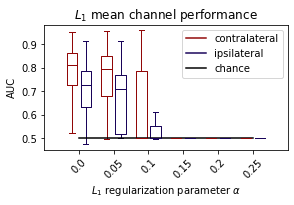

In [708]:
plt.figure(figsize=(4,3))
my_boxplot(reg_lasso_con, reg_lasso_ips)
plt.xticks(range(0, len(alpha_lasso) * 2, 2), np.round(alpha_lasso,2))
plt.xlabel(r'$L_1$'+ ' regularization parameter '+ r'$\alpha$')
plt.ylabel('AUC')
plt.plot([0.5 for i in range(11)], color='black', label='chance')
plt.legend()
plt.title(r'$L_1$ mean channel performance')


In [712]:
np.std(reg_lasso_ips[0])

0.09704048839017405

### calculate best performans here no regularization for individual channel 

In [15]:
model = LinearRegression()
patients_con = get_performance(model, con=True)
patients_ips = get_performance(model, con=False)
stn_performance_con = get_performance_stn(LinearRegression(), con=True)
stn_performance_ips = get_performance_stn(LinearRegression(), con=False)

DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065
DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065


### calculate grid performance with a simple LM 

In [16]:
#pro Patient durchgehen und checken wie die einzelne Performance ist
patient_performance = []
for patient_idx in range(16):
    print(list_DBS_folder[patient_idx])
    unit_patient = np.zeros(94)
    
    for unit in np.unique(np.nonzero(act_arr[np.nonzero(patient_arr == patient_idx)[0],:])[1]):
        start = 0
        for sess in np.nonzero(patient_arr == patient_idx)[0]:
            if act_arr[sess, unit] == False:
                continue
            if start == 0:
                start = 1
                dat_comb = np.load('../final/corr_stream/stream_session_'+str(sess)+'_unit_'+str(unit)+'.npy')
                label_comb = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
            else:
                dat_comb = np.concatenate((dat_comb, np.load('../final/corr_stream/stream_session_'+str(sess)+'_unit_'+str(unit)+'.npy')), axis=0)
                label_comb = np.concatenate((label_comb, np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')), axis=0)
        model = LinearRegression()    
        X = dat_comb
        y = label_comb
        try:
            unit_patient[unit] = np.mean(cross_val_score(model, X, y>0, cv=5, scoring='roc_auc', n_jobs=1)) 
        except:
            unit_patient[unit] = 0.5
    patient_performance.append(unit_patient)

        

DBS4017
DBS4029
DBS4011
DBS4020
DBS4033
DBS4032
DBS4004
DBS4025
DBS4022
DBS4014
DBS4024
DBS4037
DBS4030
DBS4031
DBS4009
DBS4065


### display mean +- std performance for LM 

In [731]:
# mean values 
arr_perf = np.zeros([16, 6])
for patient in range(16):
    arr_perf[patient, 0] = np.round(np.mean(patients_con[patient]),2)
    arr_perf[patient, 1] = np.round(np.std(patients_con[patient]),2)
    arr_perf[patient, 2] = np.round(np.max(patients_con[patient]),2)
    arr_perf[patient, 3] = np.round(np.mean(patients_ips[patient]),2)
    arr_perf[patient, 4] = np.round(np.std(patients_ips[patient]),2)
    arr_perf[patient, 5] = np.round(np.max(patients_ips[patient]),2)

In [738]:
best_stn_con = []; best_stn_ips = []
for patient_idx in range(16):
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    best_stn_con.append(np.max(stn_performance_con[patient_idx]))
    best_stn_ips.append(np.max(stn_performance_ips[patient_idx]))

In [746]:
len(best_stn_con)

12

In [745]:
print(np.mean(best_stn_con))
print(np.std(best_stn_con))
print(np.mean(best_stn_ips))
print(np.std(best_stn_ips))

0.7613409166564152
0.11679095599311107
0.71538432383171
0.09317736152837806


In [747]:
# STN Con vs Ips
scipy.stats.ttest_ind(best_stn_con, best_stn_ips)

Ttest_indResult(statistic=1.0201785149264169, pvalue=0.31873209502704053)

In [741]:
# t test con vs ips
scipy.stats.ttest_ind(arr_perf[:, 2], arr_perf[:, 5])

Ttest_indResult(statistic=3.26319405221198, pvalue=0.0027503035242032194)

In [749]:
scipy.stats.ttest_ind(arr_perf[:, 5], best_stn_ips)

Ttest_indResult(statistic=1.4144637468569428, pvalue=0.1690903403166199)

In [750]:
scipy.stats.ttest_ind(arr_perf[:, 2], best_stn_con)

Ttest_indResult(statistic=2.7245255987895973, pvalue=0.01135976180169412)

In [756]:
print(scipy.stats.ttest_1samp(arr_perf[:, 2], 0.5)) #ECoG con
print(scipy.stats.ttest_1samp(arr_perf[:, 5], 0.5)) #ECoG ips
print(scipy.stats.ttest_1samp(best_stn_con, 0.5)) #STN con
print(scipy.stats.ttest_1samp(best_stn_ips, 0.5)) #STN ips

Ttest_1sampResult(statistic=19.279039076695877, pvalue=5.367379731479381e-12)
Ttest_1sampResult(statistic=11.60284933797056, pvalue=6.837902324738376e-09)
Ttest_1sampResult(statistic=7.421548659709556, pvalue=1.323592465410486e-05)
Ttest_1sampResult(statistic=7.666550932080459, pvalue=9.768854610412694e-06)


In [764]:
print(scipy.stats.ttest_ind(arr_perf[:, 2], arr_perf[:, 0])) #ECoG con
print(scipy.stats.ttest_ind(arr_perf[:, 5], arr_perf[:, 3])) #ECoG ips
print(scipy.stats.ttest_ind(best_stn_con, np.concatenate(stn_performance_con))) #STN con
print(scipy.stats.ttest_ind(best_stn_ips, np.concatenate(stn_performance_ips))) #STN ips

Ttest_indResult(statistic=3.5210161745605304, pvalue=0.001396590857965123)
Ttest_indResult(statistic=2.0899485546430383, pvalue=0.04520065344357198)
Ttest_indResult(statistic=2.1599618820769373, pvalue=0.03384689495648241)
Ttest_indResult(statistic=2.539490471061631, pvalue=0.013089876251343217)


In [18]:
df

,patient,mean con,std con,best con,mean ips,std ips,best ips
0,DBS4017,0.93,0.01,0.94,0.89,0.02,0.89
1,DBS4029,0.88,0.04,0.94,0.79,0.02,0.79
2,DBS4011,0.77,0.14,0.95,0.56,0.05,0.56
3,DBS4020,0.81,0.05,0.88,0.76,0.04,0.76
4,DBS4033,0.72,0.04,0.77,0.85,0.05,0.85
5,DBS4032,0.79,0.08,0.87,0.72,0.08,0.72
6,DBS4004,0.77,0.12,0.92,0.69,0.07,0.69
7,DBS4025,0.78,0.06,0.86,0.72,0.04,0.72
8,DBS4022,0.88,0.06,0.95,0.72,0.02,0.72
9,DBS4014,0.68,0.04,0.75,0.65,0.06,0.65


### display performance channels and grid STN 

In [127]:
def plot_STN_with_grid(x_grid, y_grid, coords_x, coords_y, val, clim_low, clim_high):
    plt.scatter(x_grid, y_grid, c='gray', s=0.25, alpha='0.5')
    plt.axis('off')
    plt.scatter(coords_x, coords_y, c = val, s = 30, alpha=1)
    cbar = plt.colorbar()
    plt.clim(clim_low, clim_high)
    cbar.remove()
    plt.axis('equal')

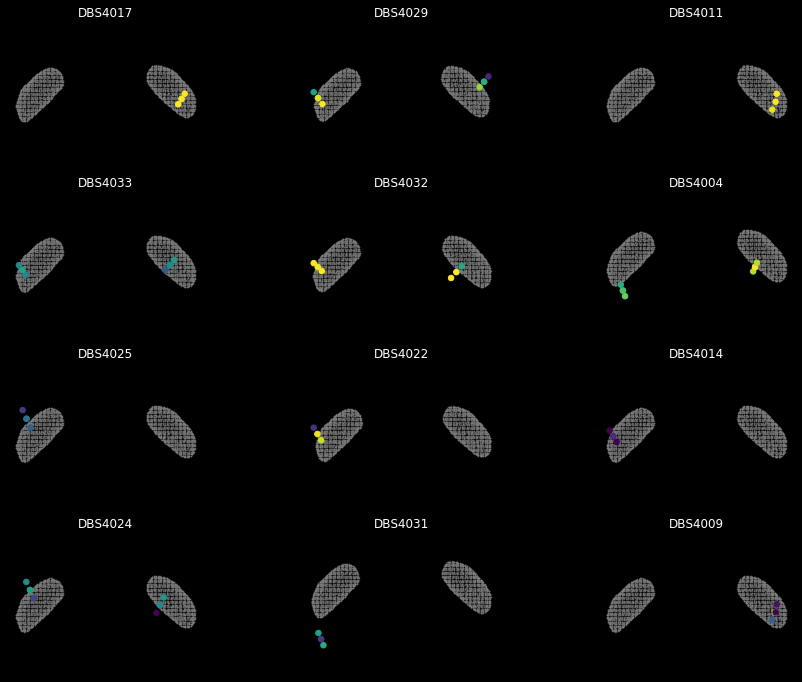

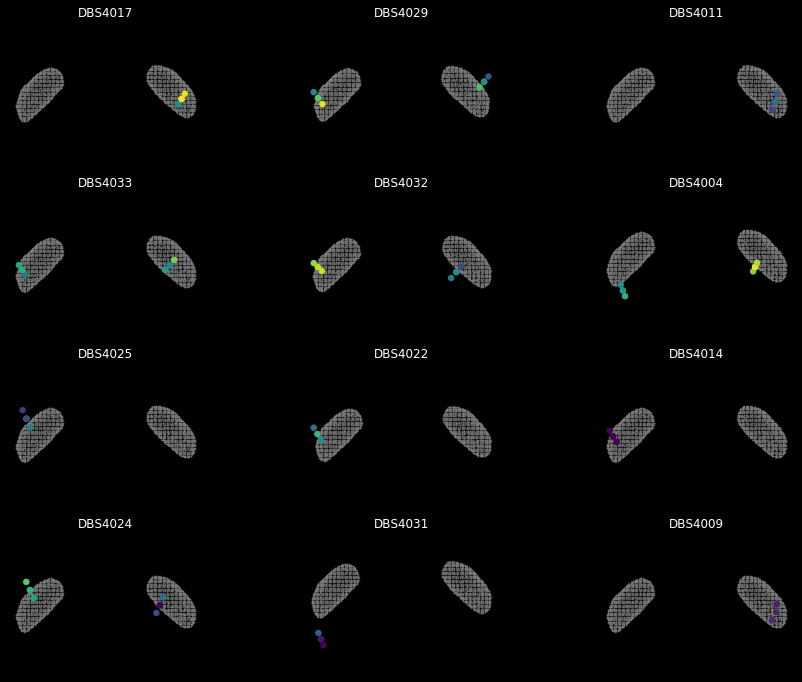

In [125]:
x_ = stn_surf['vertices'][::2,0]
y_ = stn_surf['vertices'][::2,1]

for lat in range(2):
    plt.figure(figsize=(15, 12), facecolor=(0, 0, 0))
    if lat == 0: 
        l_coords = l_coords_con_stn; stn_performance = stn_performance_con
    else:
        l_coords = l_coords_ips_stn; stn_performance = stn_performance_ips
    plot_counter = 0


    for patient_idx in range(16):
        if len(l_coords[patient_idx]) == 0:
            continue
        plot_counter += 1
        plt.subplot(4,3,plot_counter)
        coords_ = np.array(l_coords[patient_idx])
        plot_STN(x_, y_, coords_[:,0], coords_[:,1], stn_performance[patient_idx], 0.5, 0.8)
        plt.title(list_DBS_folder[patient_idx], color='white')

In [ ]:
plt.figure(figsize=(30,9), facecolor=(0, 0, 0))
for lat_ in range(2):
    plt.subplot(1,2,lat_+1)
    if lat == 0: 
        l_coords = l_coords_con_stn; stn_performance = stn_performance_con
    else:
        l_coords = l_coords_ips_stn; stn_performance = stn_performance_ips
    for patient_idx in range(16):
        plot_STN(x_grid, y_grid, coords_x, coords_y, val, clim_low, clim_high):
            

In [41]:
patient_idx = 6
print(list_DBS_folder[patient_idx])
unit_patient = np.zeros(94)

#for unit in np.unique(np.nonzero(act_arr[np.nonzero(patient_arr == patient_idx)[0],:])[1]):
unit =92
start = 0
for sess in np.nonzero(patient_arr == patient_idx)[0]:
    if act_arr[sess, unit] == False:
        continue
    if start == 0:
        start = 1
        dat_comb = np.load('../final/corr_stream/stream_session_'+str(sess)+'_unit_'+str(unit)+'.npy')
        label_comb = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
    else:
        dat_comb = np.concatenate((dat_comb, np.load('../final/corr_stream/stream_session_'+str(sess)+'_unit_'+str(unit)+'.npy')), axis=0)
        label_comb = np.concatenate((label_comb, np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')), axis=0)
model = LinearRegression()    
X = dat_comb
y = label_comb
try:
    unit_patient[unit] = np.mean(cross_val_score(model, X, y>0, cv=5, scoring='roc_auc', n_jobs=1)) 
except:
    unit_patient[unit] = 0.5

DBS4004


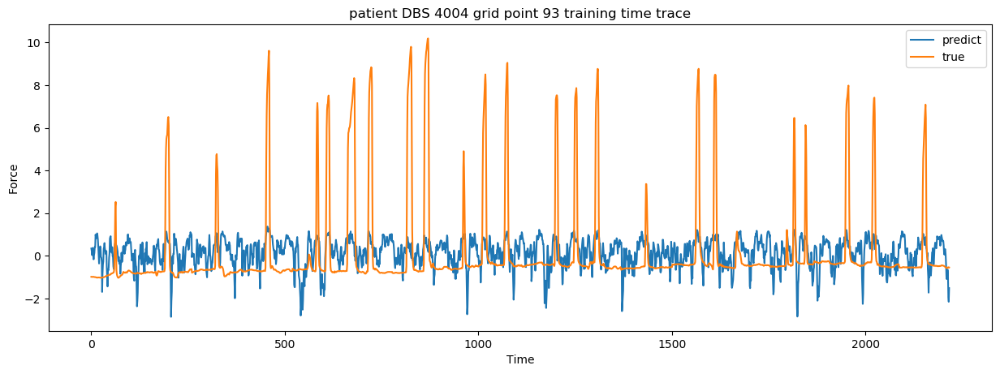

In [53]:
model = model.fit(X,y)
y_pr = model.predict(X)
plt.figure(figsize=(15,5), dpi=100)
plt.plot(y_pr, label='predict'); plt.plot(y, label='true')
plt.title('patient DBS 4004 grid point 93 training time trace'); plt.ylabel('Force'); plt.xlabel('Time'); plt.legend()

In [38]:
np.unique(np.nonzero(act_arr[np.nonzero(patient_arr == patient_idx)[0],:])[1])

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33, 34, 37, 38,
       39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55,
       57, 58, 59, 60, 62, 63, 64, 65, 66, 67, 68, 69, 71, 72, 73, 76, 77,
       78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93])

In [40]:
unit_patient[93]

0.715714730512789

In [32]:
patient_performance[6][78:][14]

0.8334968780337227

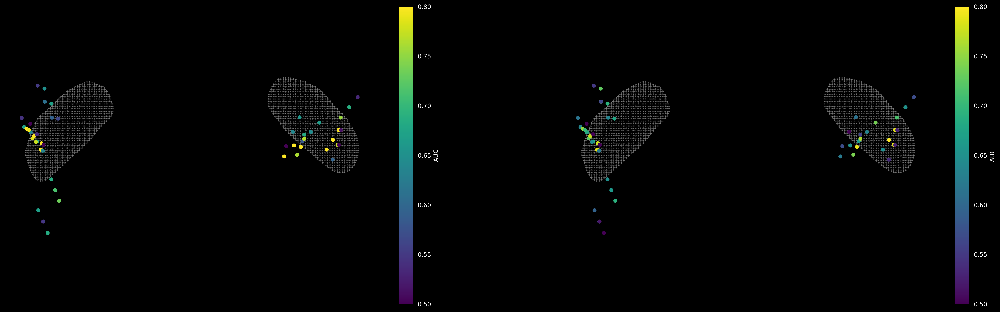

In [26]:
plt.figure(figsize=(30,9), facecolor=(0, 0, 0), dpi=300)
x_ = stn_surf['vertices'][:,0]
y_ = stn_surf['vertices'][:,1]

for lat_ in range(2):
    plt.subplot(1,2,lat_+1)
    if lat_ == 0: 
        l_coords = l_coords_con_stn; stn_performance = stn_performance_con
    else:
        l_coords = l_coords_ips_stn; stn_performance = stn_performance_ips
  
    plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
    plt.axis('off')

    for patient_idx in range(16):   
        if len(l_coords[patient_idx]) == 0:
            continue
        plt.scatter(np.array(l_coords[patient_idx])[:,0], np.array(l_coords[patient_idx])[:,1], \
                       c = np.array(stn_performance[patient_idx]), \
                       s = 30, alpha=1)
        cbar = plt.colorbar()
        plt.clim(0.5, 0.8)
        cbar.remove()

    #if lat_ == 1:
        #plt.title('ipsilateral performance across patients', color='white')
    #else:
        #plt.title('contralateral performance across patients', color='white')

    color_bar = plt.colorbar()                            
    cbytick_obj = plt.getp(color_bar.ax.axes, 'yticklabels')            
    plt.setp(cbytick_obj, color='white')
    plt.clim(0.5, 0.8)
    color_bar.set_label('AUC', color='white')
    plt.axis('equal')

plt.figure(figsize=(15,16), facecolor=(0, 0, 0), dpi=1200)
x_ = stn_surf['vertices'][:,0]
y_ = stn_surf['vertices'][:,1]
plt_counter = 0
for patient_idx in range(16):
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    plt_counter += 1
    plt.subplot(4,3, plt_counter)
    plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
    plt.axis('off')
    plt.scatter(grid[0,78:], grid[1,78:], c = patient_performance[patient_idx][78:], s = 30, alpha=1)
    color_bar = plt.colorbar()                            
    cbytick_obj = plt.getp(color_bar.ax.axes, 'yticklabels')            
    plt.setp(cbytick_obj, color='white')
    plt.clim(0.5, 0.8)
    color_bar.remove()
    color_bar.set_label('AUC', color='white')
    plt.title(list_DBS_folder[patient_idx]+str('\n con.             ips.'), color='white')
    plt.axis('equal')
    
    if len(l_coords[patient_idx]) == 0:
            continue
    plt.scatter(np.array(l_coords[patient_idx])[:,0], np.array(l_coords[patient_idx])[:,1], \
                   c = np.array(stn_performance_con[patient_idx]), \
                   s = 30, alpha=1, marker='x')
    plt.scatter(-np.array(l_coords[patient_idx])[:,0], np.array(l_coords[patient_idx])[:,1], \
                   c = np.array(stn_performance_ips[patient_idx]), \
                   s = 30, alpha=1, marker='x')
    cbar = plt.colorbar()
    plt.clim(0.5, 0.8)
    cbar.remove()


### display performance ECoG

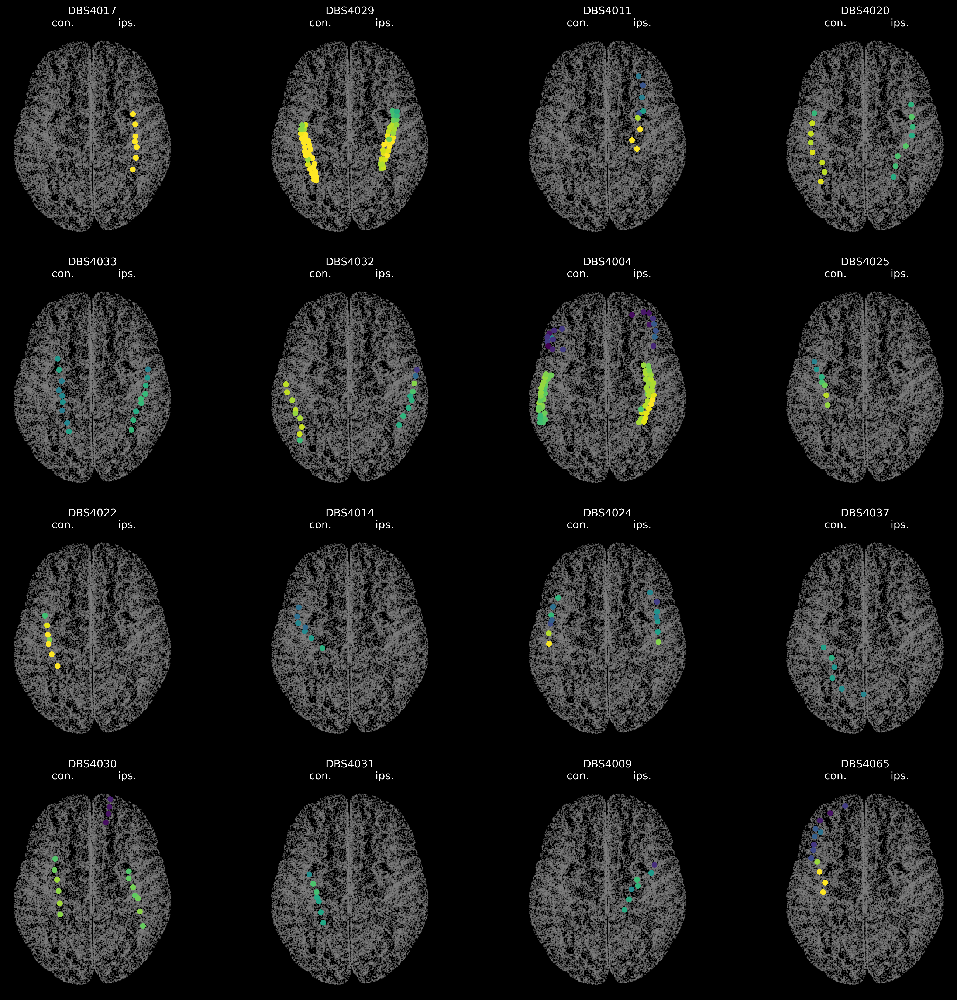

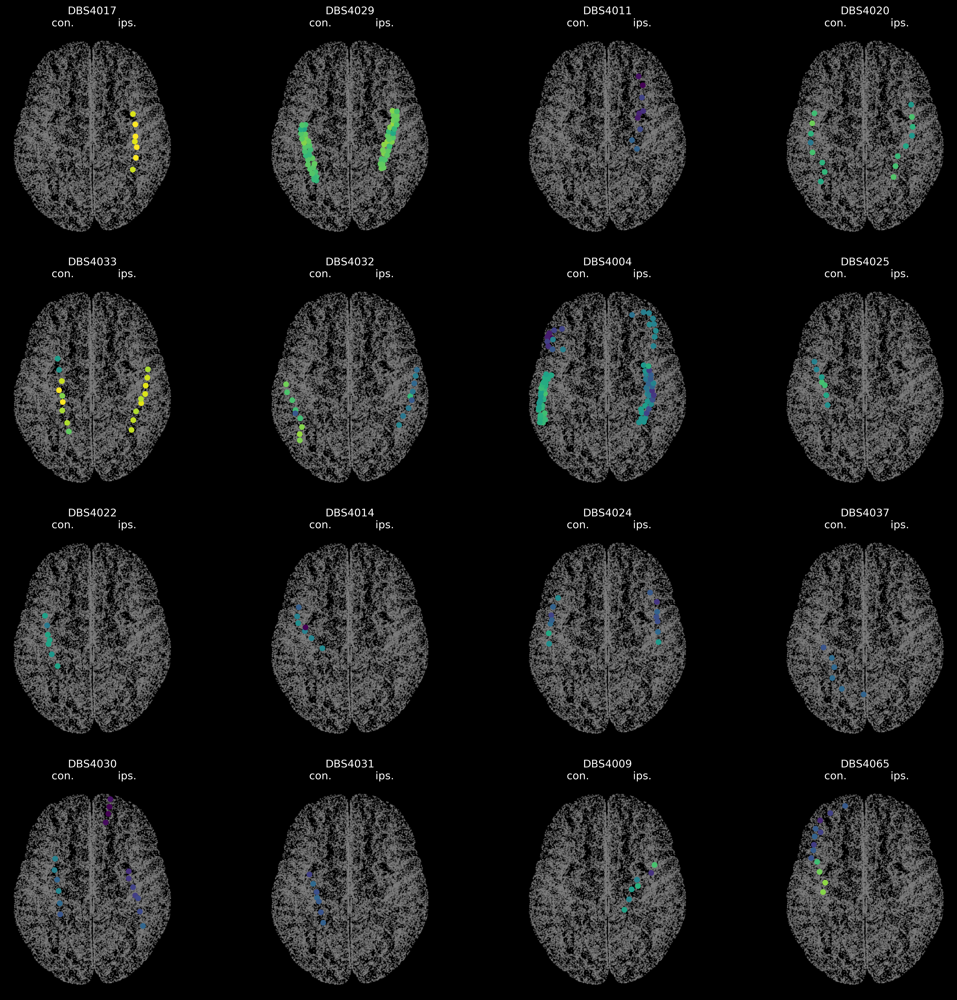

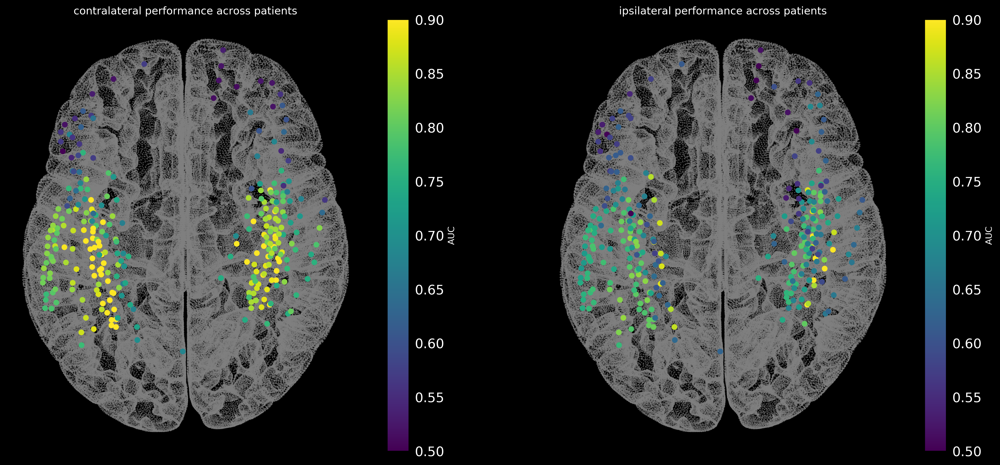

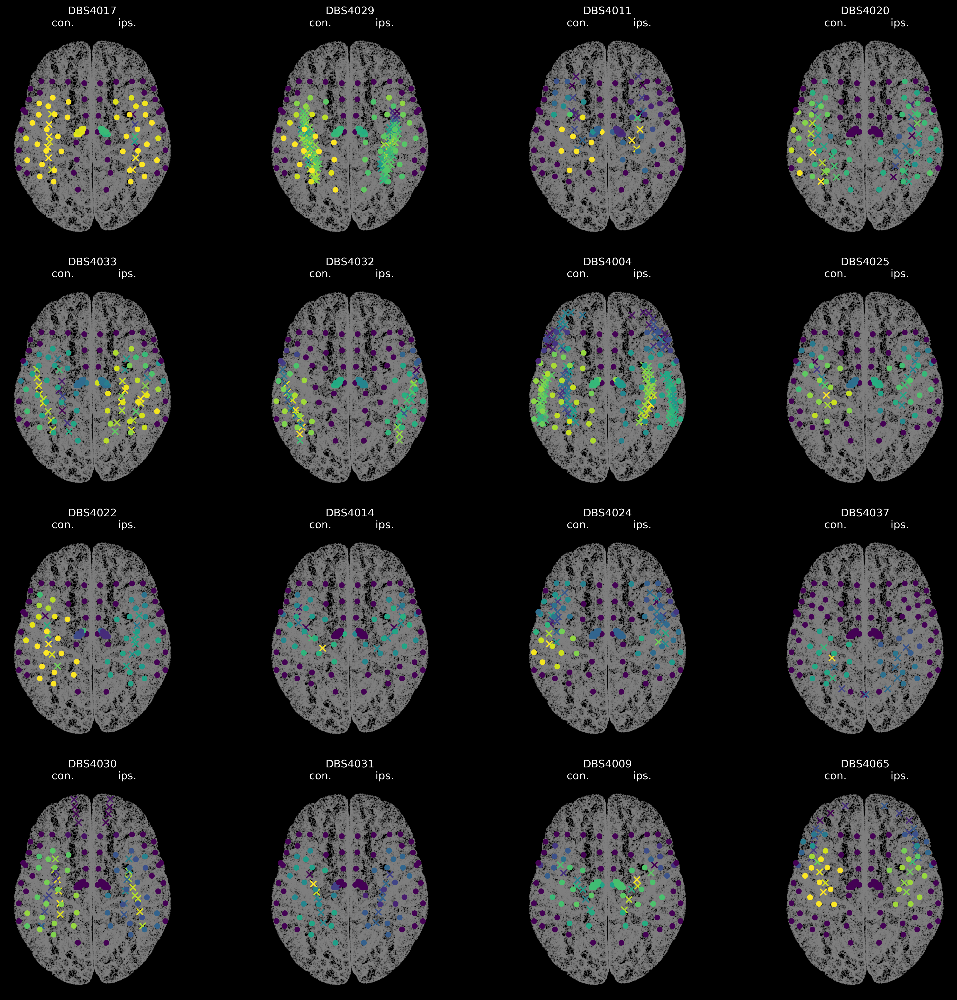

In [28]:
dpi_ = 300
plt.figure(figsize=(20,20), facecolor=(0, 0, 0), dpi=dpi_)
patient_idx = 0
x_ = Vertices['Vertices'][::10,0]
y_ = Vertices['Vertices'][::10,1]
z_ = np.zeros([x_.shape[0]])
#plt.suptitle('contralateral performances', color='white')
patient_idx = 0
for patient_idx in range(16):
    plt.subplot(4,4,patient_idx+1, facecolor=(0,0,0))
    plt.title(list_DBS_folder[patient_idx]+str('\n con.             ips.'), color='white')
    plt.axis('off')
    plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
    plt.scatter(np.array(l_coords_con[patient_idx])[:,0], np.array(l_coords_con[patient_idx])[:,1], \
                   c = np.array(patients_con[patient_idx]), \
                   s = 30, alpha=1)
    cbar = plt.colorbar()
    plt.clim(0.5, 0.9)
    cbar.remove()

#IPSI
plt.figure(figsize=(20,20), facecolor=(0, 0, 0), dpi=dpi_)
patient_idx = 0
x_ = Vertices['Vertices'][::10,0]
y_ = Vertices['Vertices'][::10,1]
z_ = np.zeros([x_.shape[0]])
#plt.suptitle('contralateral performances', color='white')
patient_idx = 0
for patient_idx in range(16):
    plt.subplot(4,4,patient_idx+1, facecolor=(0,0,0))
    plt.title(list_DBS_folder[patient_idx]+str('\n con.             ips.'), color='white')
    plt.axis('off')
    plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
    plt.scatter(np.array(l_coords_con[patient_idx])[:,0], np.array(l_coords_con[patient_idx])[:,1], \
                   c = np.array(patients_ips[patient_idx]), \
                   s = 30, alpha=1)
    cbar = plt.colorbar()
    cbar.ax.tick_params(labelsize=15)
    plt.clim(0.5, 0.9)
    cbar.remove()
    
plt.figure(figsize=(20,9), facecolor=(0, 0, 0), dpi=dpi_)
patient_idx = 0
x_ = Vertices['Vertices'][::1,0]
y_ = Vertices['Vertices'][::1,1]
z_ = np.zeros([x_.shape[0]])
for lat_ in range(2):
    plt.subplot(1,2,lat_+1)
    if lat_ == 1:
        l_coords = l_coords_ips; patients_performance = patients_ips
    else:
        l_coords = l_coords_con; patients_performance = patients_con
    plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
    plt.axis('off')

    for patient_idx in range(16):

        plt.scatter(np.array(l_coords[patient_idx])[:,0], np.array(l_coords[patient_idx])[:,1], \
                       c = np.array(patients_performance[patient_idx]), \
                       s = 30, alpha=1)
        cbar = plt.colorbar()
        plt.clim(0.5,0.9)
        cbar.remove()
    if lat_ == 1:
        plt.title('ipsilateral performance across patients', color='white')
    else:
        plt.title('contralateral performance across patients', color='white')
    
    color_bar = plt.colorbar()
    color_bar.ax.tick_params(labelsize=15)
    cbytick_obj = plt.getp(color_bar.ax.axes, 'yticklabels')            
    plt.setp(cbytick_obj, color='white')
    plt.clim(0.5,0.9)
    color_bar.set_label('AUC', color='white')

#interpolation
#plot zwischen allen Patienten
plt.figure(figsize=(20,20), facecolor=(0, 0, 0), dpi=dpi_)

x_ = Vertices['Vertices'][::4,0]
y_ = Vertices['Vertices'][::4,1]
z_ = np.zeros([x_.shape[0]])
l_coords = l_coords_con

for patient_idx in range(16):
    plt.subplot(4,4,patient_idx+1, facecolor=(0,0,0))
    plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
    plt.axis('off')
    plt.scatter(np.array(l_coords[patient_idx])[:,0], np.array(l_coords[patient_idx])[:,1], \
                       s = 50, alpha=1, marker='x', c = np.array(patients_con[patient_idx]))#c = np.array(patients_performance[patient_idx]), 
    plt.scatter(-np.array(l_coords[patient_idx])[:,0], np.array(l_coords[patient_idx])[:,1], \
                       s = 50, alpha=1, marker='x', c = np.array(patients_ips[patient_idx]))#c = np.array(patients_performance[patient_idx]), 

    cbar = plt.colorbar()                            
    plt.clim(0.5, 0.9)
    cbar.remove()
    plt.scatter(grid[0,:], grid[1,:], c = patient_performance[patient_idx], s = 30, alpha=1)

    plt.title(list_DBS_folder[patient_idx]+str('\n con.             ips.'), color='white')
    cbar = plt.colorbar()                            
    plt.clim(0.5, 0.9)
    cbar.remove()


In [723]:
l_ = []
for patient_idx in range(16):
    l_.append(np.mean(patients_ips[patient_idx]))

In [725]:
np.mean(l_)

0.6987998144493723

In [716]:
np.concatenate(patients_ips).flatten().mean()

0.7141055073457518

In [718]:
np.concatenate(patients_ips).flatten().std()

0.09640975492774857

In [717]:
np.concatenate(patients_con).flatten().mean()

0.7842034326104239

In [719]:
np.concatenate(patients_con).flatten().std()

0.1123195473585115

### time series plot für besten korrelationskoeffizient 


In [48]:
val_max = 0
for patient_idx in range(len(patients_con)):
    for ch_idx in range(len(patients_con[patient_idx])):
        if patients_con[patient_idx][ch_idx] > val_max:
            patient_max = patient_idx; ch_max = ch_idx
            val_max = patients_con[patient_idx][ch_idx]

In [49]:
patients_con[patient_max][ch_max]

0.9532597821369327

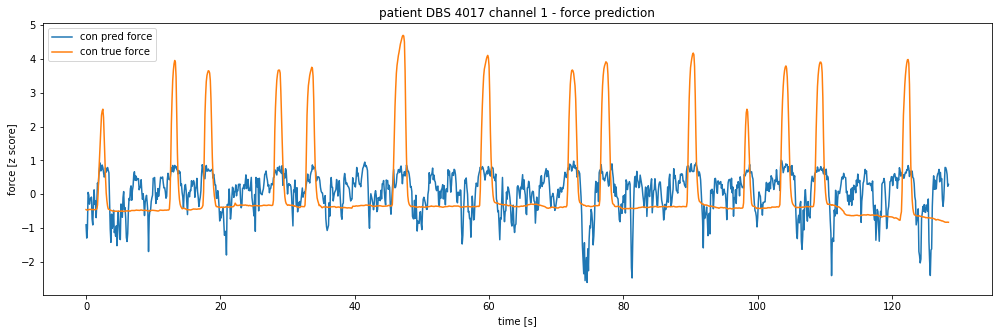

In [72]:
ch_max = 1

X_con = l_chs_con[patient_max][ch_max]; y_con = l_movs_con[patient_max][ch_max]; \
X_ips = l_chs_ips[patient_max][ch_max]; y_ips = l_movs_ips[patient_max][ch_max]; 

X_train_con, y_train_con, X_test_con, y_test_con = X_con[:3000, :], y_con[:3000], X_con[3000:,:], y_con[3000:]

reg_con = LinearRegression().fit(X_train_con, y_train_con)
reg_ips = LinearRegression().fit(X_train_ips, y_train_ips)
y_pred_con = reg_con.predict(X_test_con)
y_pred_ips = reg_ips.predict(X_test_ips)

end_point = y_test_con.shape[0]
start_point  = 0
plt.figure(figsize=(17,5))
time = np.arange(start_point, end_point, 1)*0.1
plt.plot(time, y_pred_con[start_point:], label='con pred force')
plt.plot(time, y_test_con[start_point:], label='con true force')
#plt.plot(time, y_pred_ips[start_point:end_point], label='ips pred force')
#plt.plot(time, y_test_ips[start_point:end_point], label='ips true force')
plt.xlabel('time [s]')
plt.ylabel('force [z score]')
plt.legend()
plt.title('patient DBS 4017 channel 1 - force prediction')
plt.show()

#### weights für best performing channels als boxplot darstellen

In [784]:
def my_boxplot_weights(alpha_con, alpha_ips):
    data_a = alpha_con
    data_b = alpha_ips
    ticks = [str(i) for i in range(8)]

    bpl = plt.boxplot(data_a, positions=np.array(range(8))*2.0-0.4, sym='', widths=0.6)
    bpr = plt.boxplot(data_b, positions=np.array(range(8))*2.0+0.4, sym='', widths=0.6)
    set_box_color(bpl, '#910707') # colors are from http://colorbrewer2.org/
    set_box_color(bpr, '#180359')

    # draw temporary red and blue lines and use them to create a legend
    plt.plot([], c='#910707', label='contralateral')
    plt.plot([], c='#180359', label='ipsilateral')
    plt.xticks(range(0, len(ticks) * 2, 2), [r'$\alpha$', r'$\theta$', r'$l\beta$', r'$h\beta$', \
                         r'$a\beta$', r'$l\gamma$', r'$h\gamma$', r'$a\gamma$'])
    plt.xlim(-2, len(ticks)*2)
    plt.xlabel('patient')
    plt.tight_layout()

def set_box_color(bp, color):
    plt.setp(bp['boxes'], color=color)
    plt.setp(bp['whiskers'], color=color)
    plt.setp(bp['caps'], color=color)
    plt.setp(bp['medians'], color=color)

In [785]:
weights_ = np.zeros([16, 4, 8]) #0 - ecog con, 1 - ecog ips, 2 - stn con, 3 - stn ips

for patient_idx in range(16):  
    best_ch = np.argmax(patients_con[patient_idx])
    X = l_chs_con[patient_idx][best_ch]; y = l_movs_con[patient_idx][best_ch]; 
    weights_[patient_idx, 0, :] = LinearRegression().fit(X, y).coef_
    
    best_ch = np.argmax(patients_ips[patient_idx])
    X = l_chs_ips[patient_idx][best_ch]; y = l_movs_ips[patient_idx][best_ch]; 
    weights_[patient_idx, 1, :] = LinearRegression().fit(X, y).coef_
    
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    best_ch = np.argmax(stn_performance_con[patient_idx])
    X = l_chs_con_stn[patient_idx][best_ch]; y = l_movs_con_stn[patient_idx][best_ch]; 
    weights_[patient_idx, 2, :] = LinearRegression().fit(X, y).coef_
    
    best_ch = np.argmax(stn_performance_ips[patient_idx])
    X = l_chs_ips_stn[patient_idx][best_ch]; y = l_movs_ips_stn[patient_idx][best_ch]; 
    weights_[patient_idx, 3, :] = LinearRegression().fit(X, y).coef_

In [793]:
t_stat_ecog_con = []; t_stat_ecog_ips = []; t_stat_stn_con = []; t_stat_stn_ips = []
print('ECOG Con')
for f_band in range(8):
    t_stat_ecog_con.append(scipy.stats.ttest_1samp(weights_[:,0, f_band], 0))

print('ECOG Ips')
for f_band in range(8):
    t_stat_ecog_ips.append(scipy.stats.ttest_1samp(weights_[:,1, f_band], 0))

print('STN Con')
for f_band in range(8):
    t_stat_stn_con.append(scipy.stats.ttest_1samp(weights_[:,2, f_band], 0))

print('STN Ips')
for f_band in range(8):
    t_stat_stn_ips.append(scipy.stats.ttest_1samp(weights_[:,3, f_band], 0))

ECOG Con
ECOG Ips
STN Con
STN Ips


Text(0.5, 0, 'Frequency band')

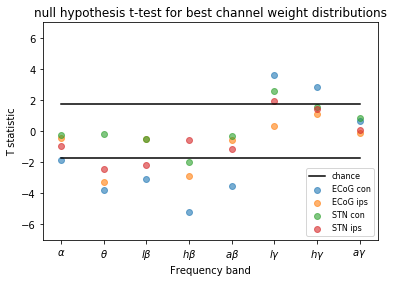

In [1223]:
plt.figure(figsize=(8,5), dpi=1000)
plt.scatter(np.arange(8), np.array(t_stat_ecog_con)[:,0], label='ECoG con', alpha=0.6)
plt.scatter(np.arange(8), np.array(t_stat_ecog_ips)[:,0], label='ECoG ips',alpha=0.6)
plt.scatter(np.arange(8), np.array(t_stat_stn_con)[:,0], label='STN con',alpha=0.6)
plt.scatter(np.arange(8), np.array(t_stat_stn_ips)[:,0], label='STN ips',alpha=0.6)
plt.xticks(np.arange(8), [r'$\alpha$', r'$\theta$', r'$l\beta$', r'$h\beta$', \
                         r'$a\beta$', r'$l\gamma$', r'$h\gamma$', r'$a\gamma$'])
plt.ylabel('T statistic')
plt.plot([-1.746 for i in range(8)], label='chance', color='black')
plt.plot([1.746 for i in range(8)], color='black')
plt.legend(loc='lower right',  prop={'size': 8})
plt.ylim(-7, 7)
plt.title('Null hypothesis t-test for best channel weight distributions')
plt.xlabel('Frequency band')

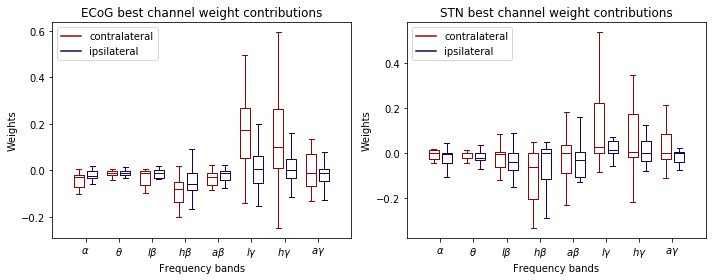

In [1222]:
plt.figure(figsize=(10, 4))
plt.subplot(1,2,1)
my_boxplot_weights(weights_[:,0, :],  weights_[:,1, :])
plt.legend()
plt.ylabel('Weights')
plt.title('ECoG best channel weight contributions')
plt.xlabel('Frequency bands')

plt.subplot(1,2,2)
my_boxplot_weights(weights_[:,2, :],  weights_[:,3, :])
plt.legend(loc='upper left')
plt.title('STN best channel weight contributions')
plt.ylabel('Weights')
plt.tight_layout()
plt.xlabel('Frequency bands')
plt.show()

### t tests

In [842]:
#get best channel contra -and ipsilaterally ECoG & STN
max_grid_ecog_con = []; max_grid_ecog_ips = []; max_grid_stn_con = []; max_grid_stn_ips = []
for patient_idx in range(16):
    max_grid_ecog_con.append(np.max(patient_performance[patient_idx][:38]))
    max_grid_ecog_ips.append(np.max(patient_performance[patient_idx][38:76]))
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    max_grid_stn_con.append(np.max(patient_performance[patient_idx][76:76+9]))
    max_grid_stn_ips.append(np.max(patient_performance[patient_idx][76+9:]))

max_ch_ecog_con = []; max_ch_ecog_ips = []; max_ch_stn_con = []; max_ch_stn_ips = []
for patient_idx in range(16):
    max_ch_ecog_con.append(np.max(patients_con[patient_idx]))
    max_ch_ecog_ips.append(np.max(patients_ips[patient_idx]))
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    max_ch_stn_con.append(np.max(stn_performance_con[patient_idx]))
    max_ch_stn_ips.append(np.max(stn_performance_ips[patient_idx]))


In [889]:
np.mean(max_ch_stn_con) - np.mean(max_grid_stn_con)

0.06249410979658687

In [881]:
print(np.std(max_grid_stn_con))

0.11708194457119564


In [883]:
scipy.stats.ttest_ind(max_grid_stn_con, max_grid_stn_ips)

Ttest_indResult(statistic=0.13269675197342454, pvalue=0.8956394489150097)

In [981]:
np.mean(max_grid_stn_con)

0.6988468068598284

In [982]:
np.std(max_grid_stn_con)

0.11708194457119564

In [844]:
scipy.stats.ttest_ind(max_ch_ecog_con, max_grid_ecog_con)

Ttest_indResult(statistic=0.16443004725866653, pvalue=0.8704955046583507)

In [846]:
scipy.stats.ttest_ind(max_ch_ecog_ips, max_grid_ecog_ips)

Ttest_indResult(statistic=-0.024426248523900677, pvalue=0.9806743656684954)

In [847]:
scipy.stats.ttest_ind(max_ch_stn_con, max_grid_stn_con)

Ttest_indResult(statistic=1.2533437174231197, pvalue=0.22323767878015577)

In [848]:
scipy.stats.ttest_ind(max_ch_stn_ips, max_grid_stn_ips)

Ttest_indResult(statistic=0.5104515082048594, pvalue=0.6148189981694168)

In [1003]:
def my_box_plot_comparison(data_a, data_b, num_ =4, label_1 ='raw channel', label_2 ='grid'):
    ticks = [str(i) for i in range(num_)]
    bpl = plt.boxplot(data_a, positions=np.array(range(num_))*2.0-0.4, sym='', widths=0.6)
    bpr = plt.boxplot(data_b, positions=np.array(range(num_))*2.0+0.4, sym='', widths=0.6)
    set_box_color(bpl, '#910707') # colors are from http://colorbrewer2.org/
    set_box_color(bpr, '#180359')

    # draw temporary red and blue lines and use them to create a legend
    plt.plot([], c='#910707', label=label_1)
    plt.plot([], c='#180359', label=label_2)

    plt.xlim(-2, len(ticks)*2)
    plt.tight_layout()
    plt.xticks(range(0, len(ticks) * 2, 2), ['ECoG con', 'ECoG ips', 'STN con', 'STN ips'], rotation=45)
    plt.ylabel('AUC')

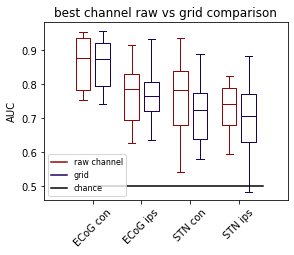

In [1004]:
plt.figure(figsize=(4,3))
my_box_plot_comparison([max_ch_ecog_con, max_ch_ecog_ips, max_ch_stn_con, max_ch_stn_ips], \
           [max_grid_ecog_con, max_grid_ecog_ips, max_grid_stn_con, max_grid_stn_ips], 4)
plt.plot([0.5 for i in range(8)], label='chance', color = 'black')
plt.legend(loc='lower left', prop={'size': 8})
plt.title('best channel raw vs grid comparison')
plt.show()

In [ ]:
# individueller Vergleich zwischen Patient_performance und Channel direct performance

In [133]:
ecog_con = np.zeros(16); ecog_ips = np.zeros(16); stn_con = np.zeros(16); stn_ips = np.zeros(16)

for patient_idx in range(16):
    
    interpolated_ = patient_performance[patient_idx][:38]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    ecog_con[patient_idx] = scipy.stats.ttest_ind(patients_con[patient_idx], interpolated_)[0]
    
    if len(stn_performance_con[patient_idx]) == 0:
        interpolated_ = patient_performance[patient_idx][78:86]
        interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
        stn_con[patient_idx] = scipy.stats.ttest_ind(stn_performance_con[patient_idx], interpolated_)[0]
    
    interpolated_ = patient_performance[patient_idx][38:78]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    ecog_ips[patient_idx] = scipy.stats.ttest_ind(patients_ips[patient_idx], interpolated_)[0]
    
    
    interpolated_ = patient_performance[patient_idx][86:]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    stn_ips[patient_idx] = scipy.stats.ttest_ind(stn_performance_ips[patient_idx], interpolated_)[0]



#### ECOG Analyse channel vs Interpolation

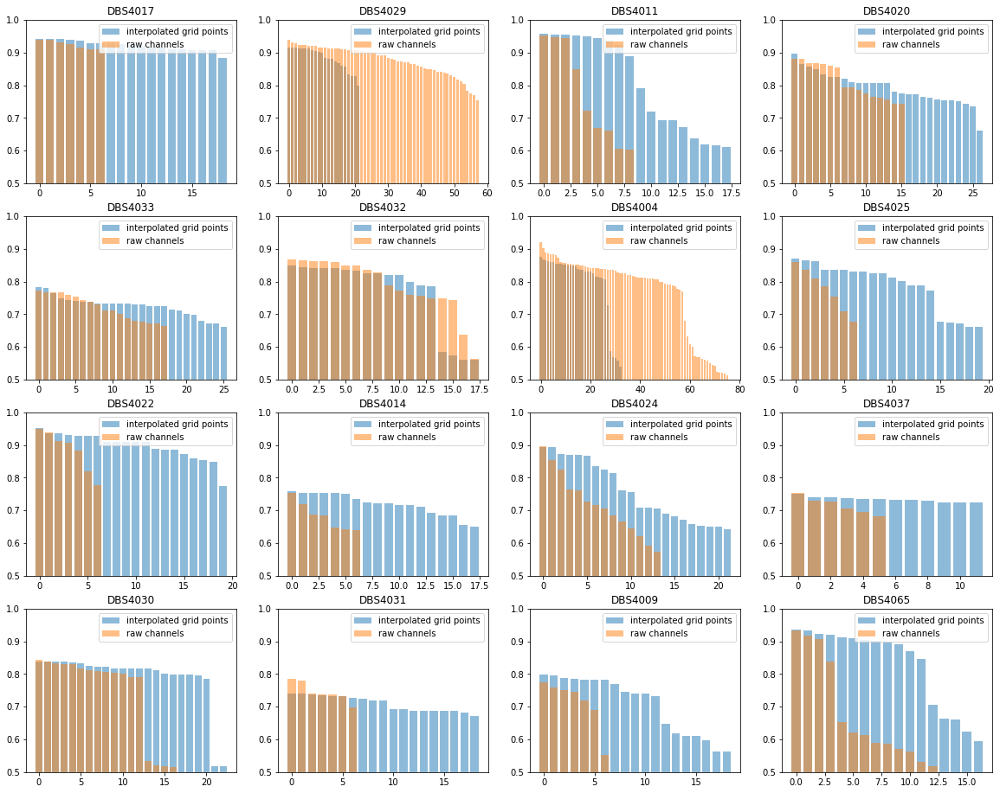

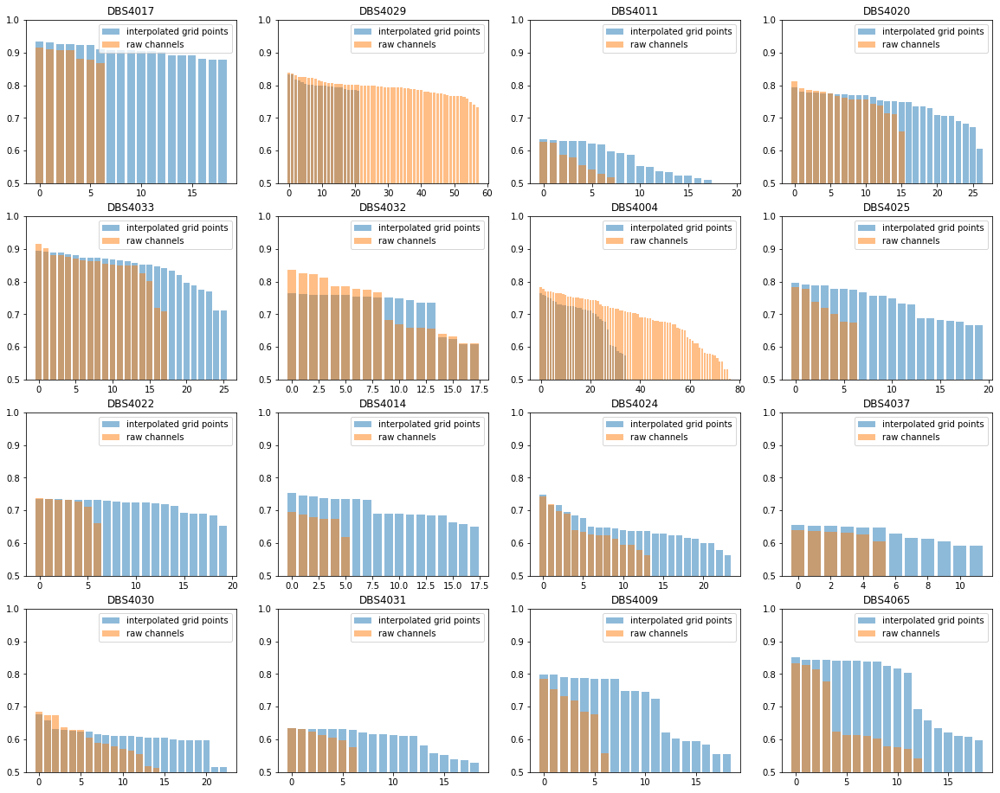

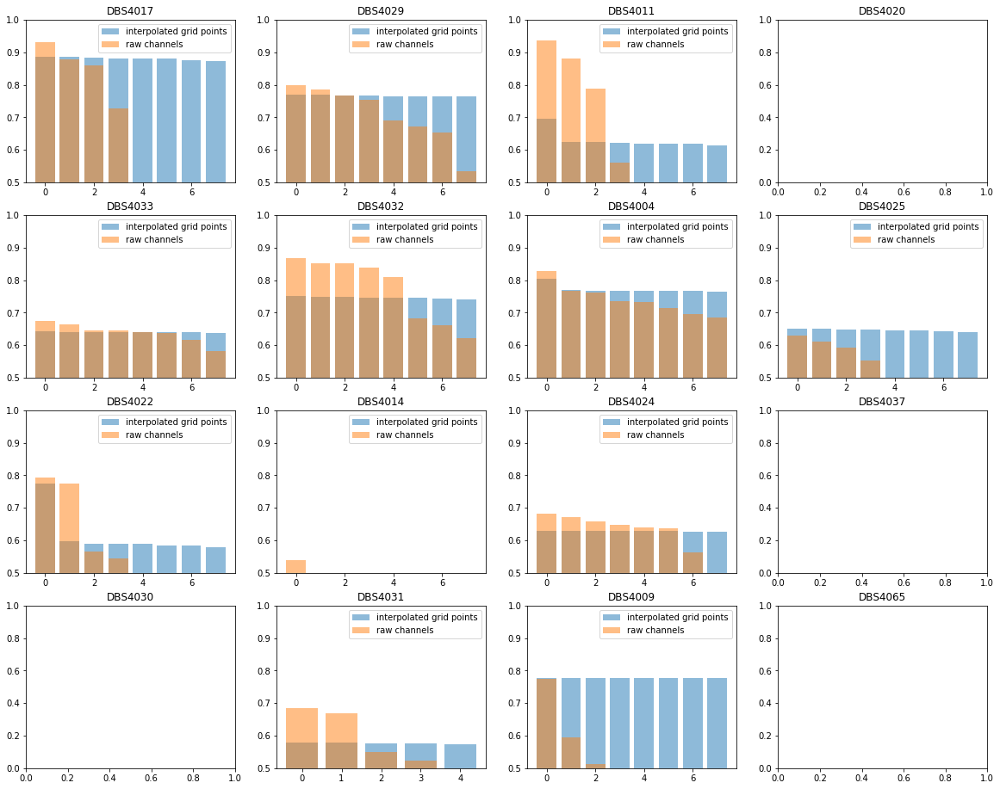

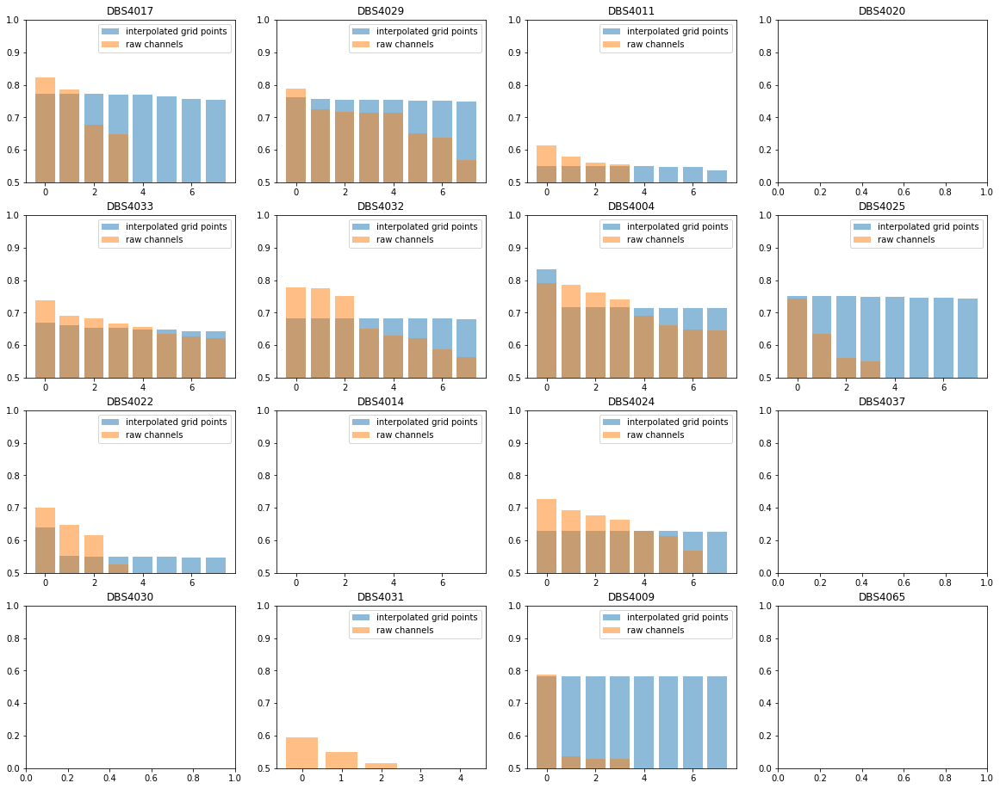

In [92]:
#CONTRA Channel vs Grid
best_ = np.zeros([16, 4]) # 0 - con/inter, 1 - con/channel, 2 - ips/inter, 3 - ips/channel
plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    interpolated_ = patient_performance[patient_idx][:38]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated grid points', alpha=0.5)
    plt.bar(np.arange(len(patients_con[patient_idx])), np.sort(patients_con[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_[patient_idx, 0] = np.max(interpolated_)
    best_[patient_idx, 1] = np.max(patients_con[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

#IPSI Channel vs Grid
plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    interpolated_ = patient_performance[patient_idx][38:78]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated grid points', alpha=0.5)
    plt.bar(np.arange(len(patients_ips[patient_idx])), np.sort(patients_ips[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_[patient_idx, 2] = np.max(interpolated_)
    best_[patient_idx, 3] = np.max(patients_ips[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

# CONTRA Channel vs Grid STN
best_stn = np.zeros([16, 4]) # 0 - con/inter, 1 - con/channel, 2 - ips/inter, 3 - ips/channel
plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    interpolated_ = patient_performance[patient_idx][78:86]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated grid points', alpha=0.5)
    plt.bar(np.arange(len(stn_performance_con[patient_idx])), np.sort(stn_performance_con[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_stn[patient_idx, 0] = np.max(interpolated_)
    best_stn[patient_idx, 1] = np.max(patients_con[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

# Ipsi Channel vs Grid STN
plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    interpolated_ = patient_performance[patient_idx][86:]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated grid points', alpha=0.5)
    plt.bar(np.arange(len(stn_performance_ips[patient_idx])), np.sort(stn_performance_ips[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_stn[patient_idx, 2] = np.max(interpolated_)
    best_stn[patient_idx, 3] = np.max(patients_ips[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

#### STN Analyse Grid vs STN

In [160]:
def my_box_plot_comparison(data_a, data_b):

    ticks = [str(i) for i in range(2)]
    bpl = plt.boxplot(data_a, positions=np.array(range(2))*2.0-0.4, sym='', widths=0.6)
    bpr = plt.boxplot(data_b, positions=np.array(range(2))*2.0+0.4, sym='', widths=0.6)
    set_box_color(bpl, '#910707') # colors are from http://colorbrewer2.org/
    set_box_color(bpr, '#180359')

    # draw temporary red and blue lines and use them to create a legend
    plt.plot([], c='#910707', label='contralateral')
    plt.plot([], c='#180359', label='ipsilateral')

    plt.xlim(-2, len(ticks)*2)
    plt.xlabel('frequency bands')
    plt.tight_layout()
    plt.xticks(range(0, len(ticks) * 2, 2), ['interpolation grid', 'raw channels'], rotation=45)
    plt.ylabel('AUC')

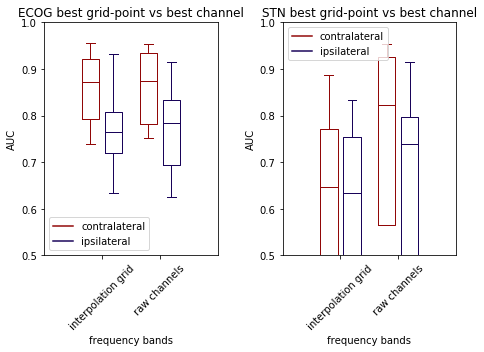

In [161]:
plt.figure(figsize=(6.7, 5))
plt.subplot(121)
my_box_plot_comparison(np.concatenate((np.expand_dims(best_[:,0], axis=1), \
                                       np.expand_dims(best_[:,1], axis=1)), axis=1), \
                       np.concatenate((np.expand_dims(best_[:,2], axis=1), \
                                       np.expand_dims(best_[:,3], axis=1)), axis=1))
plt.title('ECOG best grid-point vs best channel')
plt.ylim(0.5, 1)
plt.legend()
plt.subplot(122)
my_box_plot_comparison(np.concatenate((np.expand_dims(best_stn[:,0], axis=1), \
                                       np.expand_dims(best_stn[:,1], axis=1)), axis=1), \
                       np.concatenate((np.expand_dims(best_stn[:,2], axis=1), \
                                       np.expand_dims(best_stn[:,3], axis=1)), axis=1))
plt.title('STN best grid-point vs best channel')
plt.ylim(0.5, 1)
plt.legend()
plt.tight_layout()

In [140]:
print('ECOG contralateral grid vs channel: ')
print(scipy.stats.ttest_ind(best_[:,0], best_[:,1]))
print()
print('ECOG ipsilateral grid vs channel ')
print(scipy.stats.ttest_ind(best_[:,2], best_[:,3]))
print();print()
print('STN contralateral grid vs channel: ')
print(scipy.stats.ttest_ind(best_stn[:,0], best_stn[:,1]))
print()
print('STN ipsilateral grid vs channel ')
print(scipy.stats.ttest_ind(best_stn[:,2], best_stn[:,3]))

ECOG contralateral grid vs channel: 
Ttest_indResult(statistic=-0.16443004725866653, pvalue=0.8704955046583507)

ECOG ipsilateral grid vs channel 
Ttest_indResult(statistic=0.014107387201422055, pvalue=0.9888377097490719)


STN contralateral grid vs channel: 
Ttest_indResult(statistic=-0.9873816735511552, pvalue=0.33135267389105694)

STN ipsilateral grid vs channel 
Ttest_indResult(statistic=-0.6490374961562002, pvalue=0.5212523322408585)


### plot count of best channels

In [96]:
best_counts = np.zeros(94)
for patient_idx in range(16):
    patient_performance[patient_idx]
    best_counts[np.argmax(patient_performance[patient_idx][:38])] += 1
    best_counts[np.argmax(patient_performance[patient_idx][38:78])+38] += 1
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    best_counts[np.argmax(patient_performance[patient_idx][78:86])+78] += 1
    best_counts[np.argmax(patient_performance[patient_idx][86:])+86] += 1

(-16.417501497101508,
 16.444165684790853,
 -18.053809357360006,
 -7.7812698357552215)

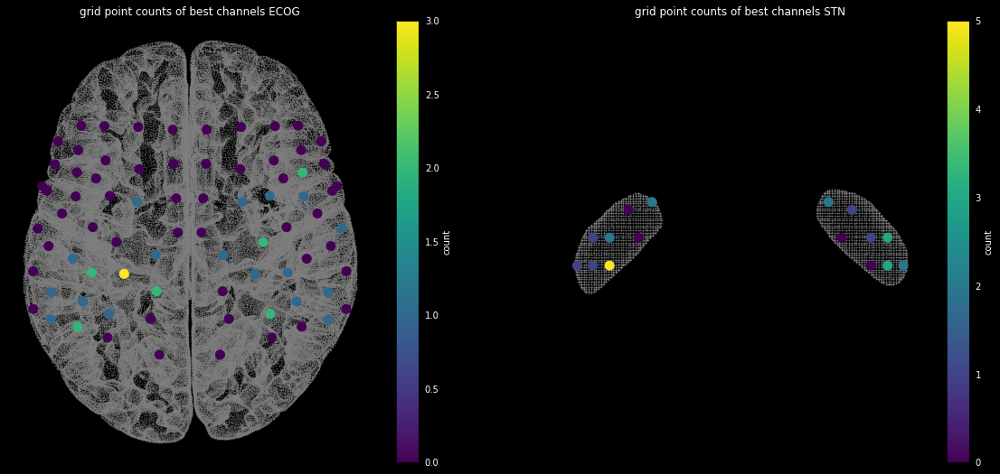

In [1227]:
plt.figure(figsize=(20,9), facecolor=(0, 0, 0))
plt.subplot(1,2,1)
x_ = Vertices['Vertices'][::1,0]
y_ = Vertices['Vertices'][::1,1]
plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
plt.axis('off')
plt.scatter(grid[0,:78], grid[1,:78], c =best_counts[:78], s = 100, alpha=1)

plt.title('grid point counts of best channels ECOG', color='white')
color_bar = plt.colorbar()               
color_bar.set_label('count', color='white')
cbytick_obj = plt.getp(color_bar.ax.axes, 'yticklabels')            
plt.setp(cbytick_obj, color='white')                         

plt.subplot(1,2,2)
x_ = stn_surf['vertices'][:,0]
y_ = stn_surf['vertices'][:,1]
plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
plt.axis('off')
plt.scatter(grid[0,78:], grid[1,78:], c = best_counts[78:], s = 100, alpha=1)
color_bar = plt.colorbar()                            
cbytick_obj = plt.getp(color_bar.ax.axes, 'yticklabels')            
plt.setp(cbytick_obj, color='white')
color_bar.set_label('count', color='white')
plt.title('grid point counts of best channels STN', color='white')
plt.axis('equal')

In [ ]:
#plot count of best grid point from CV RF 32 

In [1235]:
38*2

76

(-16.417501497101508,
 16.444165684790853,
 -18.053809357360006,
 -7.7812698357552215)

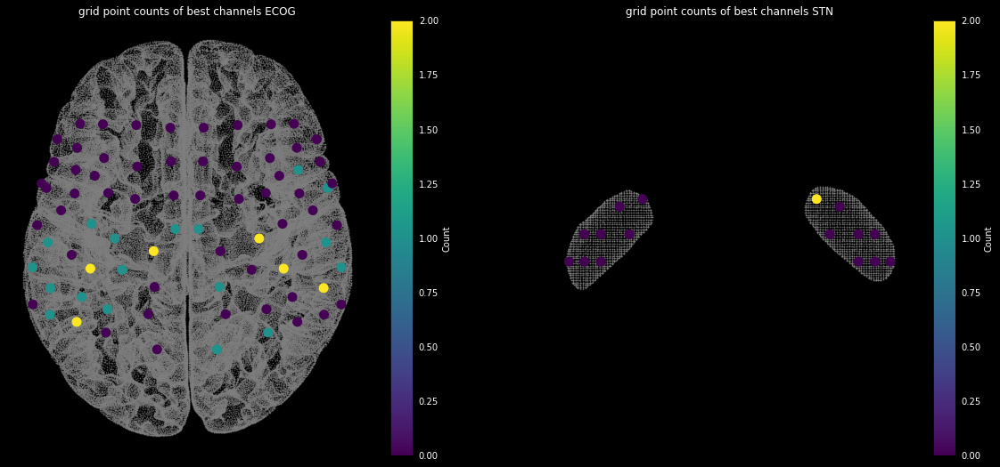

In [1247]:
best_counts = np.zeros(94) 
for grid_point in np.array([50, 54, 50, 64, 47, 47, 92, 92, 40, 56, 51, 55, 67, 39, 48, 55]):
    best_counts[grid_point] += 1
for grid_point in np.array([2, 15, 11, 3, 2, 11, 19, 14, 7, 14, 12, 16, 8, 5, 17, 10]):
    best_counts[grid_point] += 1

plt.figure(figsize=(20,9), facecolor=(0, 0, 0))
plt.subplot(1,2,1)
x_ = Vertices['Vertices'][::1,0]
y_ = Vertices['Vertices'][::1,1]
plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
plt.axis('off')
plt.scatter(grid[0,:78], grid[1,:78], c =best_counts[:78], s = 100, alpha=1)

plt.title('grid point counts of best channels ECOG', color='white')
color_bar = plt.colorbar()               
color_bar.set_label('Count', color='white')
cbytick_obj = plt.getp(color_bar.ax.axes, 'yticklabels')            
plt.setp(cbytick_obj, color='white')                         

plt.subplot(1,2,2)
x_ = stn_surf['vertices'][:,0]
y_ = stn_surf['vertices'][:,1]
plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
plt.axis('off')
plt.scatter(grid[0,78:], grid[1,78:], c = best_counts[78:], s = 100, alpha=1)
color_bar = plt.colorbar()                            
cbytick_obj = plt.getp(color_bar.ax.axes, 'yticklabels')            
plt.setp(cbytick_obj, color='white')
color_bar.set_label('Count', color='white')
plt.title('grid point counts of best channels STN', color='white')
plt.axis('equal')

In [99]:
def get_dist_arr(left = True):
    coords_hand_right = np.array([37, -25, 64]); coords_hand_left = np.array([-37, -25, 62]);
    if left == True:
        knob = coords_hand_left
        grid_ = grid[:,:38]
    else: 
        knob = coords_hand_right
        grid_ = grid[:,38:78]
    dist = np.zeros([38])
    for coord in range(38):
        dist[coord] = np.linalg.norm(grid_[:,coord] - knob)
    return dist    

def get_dist_channel_knob(patient_idx, contra = True):
    coords_hand_right = np.array([37, -25, 64]); coords_hand_left = np.array([-37, -25, 62]);
    #durch die Kontakte/Kanäle durchen, und gucken ob er links oder rechts liegt
    
    dist = np.zeros(len(l_coords_con[patient_idx]))
    if contra == True:
        coords = np.array(l_coords_con[patient_idx]).T
    else: 
        coords = np.array(l_coords_ips[patient_idx]).T
        
    for ch in range(coords.shape[1]):
        if coords[0,ch] < 0:
            #left
            dist[ch] = np.linalg.norm(coords[:, ch] - coords_hand_left)
        else: 
            dist[ch] = np.linalg.norm(coords[:, ch] - coords_hand_right)
    return dist   

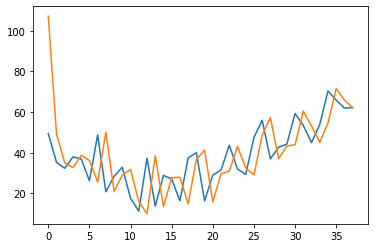

In [100]:
### Analyze Correlation Coefficient with distance to Hand knob 
# wieso zwei rechts auf z verschoben 

dist_left = get_dist_arr(left = True)
dist_right = get_dist_arr(left = False)
plt.plot(dist_left, label='left distance to hand knob')
plt.plot(dist_right, label='right distance to hand knob')

In [101]:
corr_knob_right = np.array([r2_score(dist_left, patient_performance[patient_idx][:38]) for patient_idx in range(16)])
corr_knob_left = np.array([r2_score(dist_right, patient_performance[patient_idx][38:76]) for patient_idx in range(16)])

In [102]:
from scipy import stats

In [103]:
r_dist_AUC = np.zeros([4, 16]) # 0-GRID contra, 1 - GRID ipsi, 2 - channels contra, 3 - channels ipsi
for patient_idx in range(16):
    r_dist_AUC[0, patient_idx] = stats.spearmanr(dist_left,patient_performance[patient_idx][:38])[0]
    r_dist_AUC[1, patient_idx] = stats.spearmanr(dist_right,patient_performance[patient_idx][38:76])[0]
    r_dist_AUC[2, patient_idx] = stats.spearmanr(get_dist_channel_knob(patient_idx, contra = True), \
                                                patients_con[patient_idx])[0]
    r_dist_AUC[3, patient_idx] = stats.spearmanr(get_dist_channel_knob(patient_idx, contra = False), \
                                                patients_ips[patient_idx])[0]

In [98]:
def my_box_plot_comparison_here(data_a, data_b):

    ticks = [str(i) for i in range(2)]
    bpl = plt.boxplot(data_a, positions=np.array(range(2))*2.0-0.4, sym='', widths=0.6)
    bpr = plt.boxplot(data_b, positions=np.array(range(2))*2.0+0.4, sym='', widths=0.6)
    set_box_color(bpl, '#910707') # colors are from http://colorbrewer2.org/
    set_box_color(bpr, '#180359')

    # draw temporary red and blue lines and use them to create a legend
    plt.plot([], c='#910707', label='contralateral')
    plt.plot([], c='#180359', label='ipsilateral')

    plt.xlim(-2, len(ticks)*2)
    plt.xlabel('frequency bands')
    plt.tight_layout()
    plt.xticks(range(0, len(ticks) * 2, 2), ['interpolation grid', 'raw channels'], rotation=45)
    

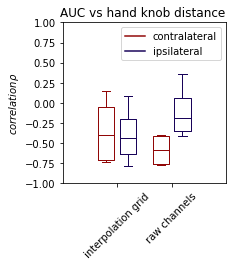

In [892]:
plt.figure(figsize=(3, 3))
my_box_plot_comparison_here(np.concatenate((np.expand_dims(r_dist_AUC[:,0], axis=1), \
                                       np.expand_dims(r_dist_AUC[:,2], axis=1)), axis=1), \
                       np.concatenate((np.expand_dims(r_dist_AUC[:,1], axis=1), \
                                       np.expand_dims(r_dist_AUC[:,3], axis=1)), axis=1))
plt.legend(loc='upper right')
plt.ylabel(r'$ correlation \rho$')
#plt.title('spearman\'s correlation coefficient distance channel/hand knob vs AUC performance across channels')
plt.title('AUC vs hand knob distance ')
plt.ylim(-1, 1)
plt.xlabel('')
plt.show()

In [387]:
mpl.use('PS')
mpl.rcParams['text.usetex']=True
mpl.rcParams['text.latex.unicode']=True

/Users/hi/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: MatplotlibDeprecationWarning: 
The text.latex.unicode rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2.
  This is separate from the ipykernel package so we can avoid doing imports until


/Users/hi/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


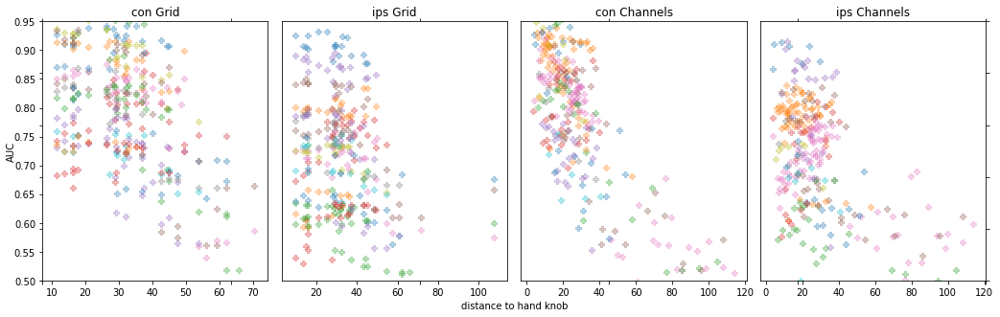

In [154]:
marker_ = 'P'
marker_size = 100
color_ = 'black'; alpha_=0.3
fig = plt.figure(figsize=(15, 5), constrained_layout=True)
ax = fig.add_subplot(111)
ax1 = fig.add_subplot(141)
ax1.set_title('con Grid')
for patient_idx in range(16):
    ax1.scatter(dist_left[np.nonzero(patient_performance[patient_idx][:38])[0]], 
                patient_performance[patient_idx][:38][np.nonzero(patient_performance[patient_idx][:38])[0]], alpha=alpha_, marker=marker_)
ax1.set_ylim(0.5, 0.95)
ax2 = fig.add_subplot(142)
ax2.set_title('ips Grid')
for patient_idx in range(16):
    ax2.scatter(dist_right[np.nonzero(patient_performance[patient_idx][38:76])[0]], 
                patient_performance[patient_idx][38:76][np.nonzero(patient_performance[patient_idx][38:76])[0]], alpha=alpha_, marker=marker_)
ax2.set_ylim(0.5, 0.95)
ax3 = fig.add_subplot(143)
ax3.set_title('con Channels')
for patient_idx in range(16):
    ax3.scatter(get_dist_channel_knob(patient_idx, contra = True), patients_con[patient_idx], alpha=alpha_, marker = marker_)
ax3.set_ylim(0.5, 0.95)
ax4 = fig.add_subplot(144)
ax4.set_title('ips Channels')
for patient_idx in range(16):
    ax4.scatter(get_dist_channel_knob(patient_idx, contra = False), patients_ips[patient_idx], alpha=alpha_, marker = marker_, label=str(patient_idx))
ax4.set_ylim(0.5, 0.95)
ax4.get_yaxis().set_visible(False)
ax3.get_yaxis().set_visible(False)
ax2.get_yaxis().set_visible(False)
# Turn off axis lines and ticks of the big subplot
ax.spines['top'].set_color('none')
ax.spines['bottom'].set_color('none')
ax.spines['left'].set_color('none')
ax.spines['right'].set_color('none')
ax.tick_params(labelcolor='w', top='off', bottom='off', left='off', right='off')
ax.set_xlabel('distance to hand knob')
ax.set_ylabel('AUC')
plt.tight_layout()

In [968]:
def plot_scatter(con=True, chan=False):
    dist_ = []
    perf_ = []
    for patient_idx in range(16):
        if chan == False:
            if con == True:
                dist_.append(dist_left[np.nonzero(patient_performance[patient_idx][:38])[0]])
                perf_.append(patient_performance[patient_idx][:38][np.nonzero(patient_performance[patient_idx][:38])[0]])
            else:
                dist_.append(dist_left[np.nonzero(patient_performance[patient_idx][38:76])[0]])
                perf_.append(patient_performance[patient_idx][38:76][np.nonzero(patient_performance[patient_idx][38:76])[0]])
        else:
            if con == True:
                dist_.append(get_dist_channel_knob(patient_idx, contra = True))
                perf_.append(patients_con[patient_idx])
            else:
                dist_.append(get_dist_channel_knob(patient_idx, contra = False))
                perf_.append(patients_ips[patient_idx])
    dist_ = np.concatenate(dist_); perf_ = np.concatenate(perf_); 
    coef = np.polyfit(dist_, perf_, 1)
    poly1d_fn = np.poly1d(coef) 
    return dist_, perf_, poly1d_fn, coef


In [1184]:
dist_, perf_, poly1d_fn, coef = plot_scatter(con=True, chan=True)
stats.spearmanr(dist_,perf_)

SpearmanrResult(correlation=-0.6035892118683917, pvalue=5.6645015711848004e-30)

In [1185]:
dist_, perf_, poly1d_fn, coef = plot_scatter(con=False, chan=True)
stats.spearmanr(dist_,perf_)

SpearmanrResult(correlation=-0.35464766968480366, pvalue=5.831572028308647e-10)

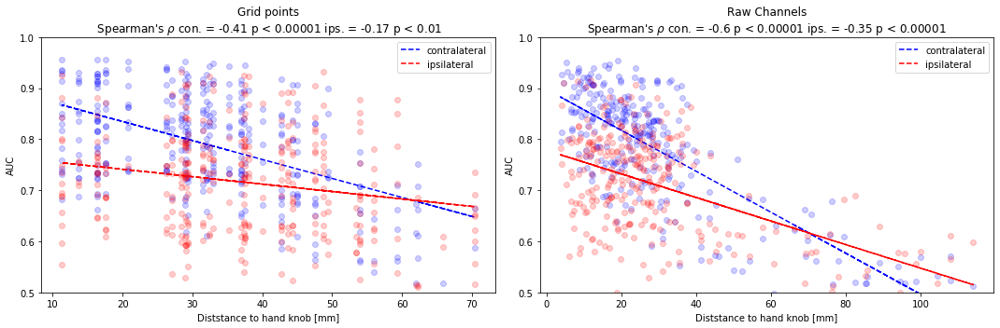

In [1189]:
plt.figure(figsize=(15,5))
plt.subplot(121)
plt.title('Grid points'+'\n Spearman\'s '+r'$\rho$'+ ' con. = '+str(-0.41) + ' p < 0.00001'+' ips. = '+str(-0.17) + ' p < 0.01')

color='b'
dist_, perf_, poly1d_fn, coef = plot_scatter(con=True)
plt.plot(dist_, perf_, str(color)+'o', alpha=0.2)
#plt.plot(dist_, poly1d_fn(dist_), '--b', label='con '+str(np.round(coef[0], 4))+'x + '+str(np.round(coef[1],2)))
plt.plot(dist_, poly1d_fn(dist_), '--b', label='contralateral')
color='r'
dist_, perf_, poly1d_fn, coef = plot_scatter(con=False)
plt.plot(dist_, perf_, str(color)+'o', alpha=0.2)
#plt.plot(dist_, poly1d_fn(dist_), '--r', label='ips '+str(np.round(coef[0], 4))+'x + '+str(np.round(coef[1],2)))
plt.plot(dist_, poly1d_fn(dist_), '--r', label='ipsilateral')
plt.legend()
plt.xlabel('Diststance to hand knob [mm]')
plt.ylabel('AUC')
plt.ylim(0.5, 1)

plt.subplot(122)
plt.title('Raw Channels'+'\nSpearman\'s '+r'$\rho$'+ ' con. = '+str(-0.6) + ' p < 0.00001'+' ips. = '+str(-0.35) + ' p < 0.00001')
color='b'
dist_, perf_, poly1d_fn, coef = plot_scatter(con=True, chan=True)
plt.plot(dist_, perf_, str(color)+'o', alpha=0.2)
#plt.plot(dist_, poly1d_fn(dist_), '--b', label='con '+str(np.round(coef[0], 4))+'x + '+str(np.round(coef[1],2)))
plt.plot(dist_, poly1d_fn(dist_), '--b', label='contralateral')
color='r'
dist_, perf_, poly1d_fn, coef = plot_scatter(con=False, chan=True)
plt.plot(dist_, perf_, str(color)+'o', alpha=0.2)
#plt.plot(dist_, poly1d_fn(dist_), '--r', label='ips '+str(np.round(coef[0], 4))+'x + '+str(np.round(coef[1],2)))
plt.plot(dist_, poly1d_fn(dist_), '--r', label='ipsilateral')
plt.legend()
plt.xlabel('Diststance to hand knob [mm]')
plt.ylabel('AUC')
plt.ylim(0.5, 1)
plt.tight_layout()

In [939]:
coef_

array([-0.00371752,  0.90902891])

### Analyze LM

In [2438]:
#wichtig: Patienten nicht sessions in der unit
for unit in range(94):
    
    print('unit: '+str(unit)+' '+ str(np.unique(patient_arr[np.nonzero(act_arr[:, unit])[0]])))

unit: 0 [ 1  3  4  6 13]
unit: 1 [ 0  1  3  4  5  6  8 11 12 13]
unit: 2 [ 0  1  3  4  5  6  8 11 12]
unit: 3 [ 3  5  6 12]
unit: 4 [ 1  3  4  6  8 11 12 13 14]
unit: 5 [ 0  1  2  3  4  5  6  7  8 11 12 13 14]
unit: 6 [6]
unit: 7 [ 0  1  3  4  5  6  7  8 10 11 12 13]
unit: 8 [ 0  3  4  5  6 10 12]
unit: 9 [ 1  2  3  4  6  7  8  9 11 12 13 14]
unit: 10 [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15]
unit: 11 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]
unit: 12 [ 3  5  6 10]
unit: 13 [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15]
unit: 14 [ 1  2  3  4  6  7  9 11 12 13 14]
unit: 15 [ 0  1  3  4  5  6  7  8  9 10]
unit: 16 [ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15]
unit: 17 [ 2  4  9 14]
unit: 18 [ 3  4  5  6 10]
unit: 19 [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]
unit: 20 [ 0  1  3  4  5  6  7  8  9 10 13 14 15]
unit: 21 [ 0  1  2  4  6  7  8  9 12 13 14 15]
unit: 22 []
unit: 23 [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15]
unit: 24 [ 0  1  2  3  4  6  7  8  9 10 12 13 1

### Kreuzvalidierung

In [983]:
def get_units_in_patient(patient_idx):
    sess_in_unit = []
    for sess in np.where(patient_arr == patient_idx)[0]:
        sess_in_unit.append(np.nonzero(act_arr[sess,:])[0])
    units_in_patient = np.unique(np.concatenate(sess_in_unit))
    return units_in_patient

In [984]:
units_to_use = np.ones([8, 94])
for unit in range(38, 78):
    units_to_use[5:8, unit] = 0
gridpoints_to_use = units_to_use

In [985]:
#pro Patient die grid points über sessions concatenieren und dann plotten
l_patient_CV_LM = []
folder = 'LM'
for patient_idx in range(16):
    units_in_patient = get_units_in_patient(patient_idx)
    cc_arr = np.zeros(94)
    for unit in units_in_patient:
        start = 0
        for sess in np.where(patient_arr == patient_idx)[0]:
            if act_arr[sess,unit] == 0:
                continue   # nicht alle units sind in allen sessions...
            if start == 0:
                try:
                    y_te_pr = np.load(str(folder)+'/y_te_pr_unit_'+str(unit)+'_session_'+str(sess)+'.npy')
                except:
                    continue   # nicht alle units sind kreuzvalidiert
                mov = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
                start = 1
            else: 
                y_te_pr = np.concatenate((y_te_pr, np.load(str(folder)+'/y_te_pr_unit_'+str(unit)+'_session_'+str(sess)+'.npy')), axis=0)
                mov = np.concatenate((mov, np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')), axis=0)
        cc_arr[unit] = roc_auc_score(mov>0, y_te_pr)
    l_patient_CV_LM.append(cc_arr)
        

In [994]:
def get_arr(arr_1, arr_2, low, high):
    return arr_1[low:high][np.nonzero(arr_1[low:high])], arr_2[low:high][np.nonzero(arr_2[low:high])]

In [996]:
max_grid_ecog_con = []; max_grid_ecog_ips = []; max_grid_stn_con = []; max_grid_stn_ips = [];
max_grid_CV_ecog_con = []; max_grid_CV_ecog_ips = []; max_grid_CV_stn_con = []; max_grid_CV_stn_ips = [];

for patient_idx in range(16):
    grid_direct, grid_CV = get_arr(patient_performance[patient_idx], l_patient_CV_LM[patient_idx], 0, 38) 
    max_grid_ecog_con.append(np.max(grid_direct))
    max_grid_CV_ecog_con.append(np.max(grid_CV))
    
    grid_direct, grid_CV = get_arr(patient_performance[patient_idx], l_patient_CV_LM[patient_idx], 38, 76) 
    max_grid_ecog_ips.append(np.max(grid_direct))
    max_grid_CV_ecog_ips.append(np.max(grid_CV))
    
    if len(stn_performance[patient_idx]) == 0:
        continue
    
    grid_direct, grid_CV = get_arr(patient_performance[patient_idx], l_patient_CV_LM[patient_idx], 76, 76+9) 
    max_grid_stn_con.append(np.max(grid_direct))
    max_grid_CV_stn_con.append(np.max(grid_CV))
    
    grid_direct, grid_CV = get_arr(patient_performance[patient_idx], l_patient_CV_LM[patient_idx], 76+9, 94) 
    max_grid_stn_ips.append(np.max(grid_direct))
    max_grid_CV_stn_ips.append(np.max(grid_CV))

In [1001]:
print(scipy.stats.ttest_ind(max_grid_ecog_con, max_grid_CV_ecog_con))
print(scipy.stats.ttest_ind(max_grid_ecog_ips, max_grid_CV_ecog_ips))
print(scipy.stats.ttest_ind(max_grid_stn_con, max_grid_CV_stn_con))
print(scipy.stats.ttest_ind(max_grid_stn_ips, max_grid_CV_stn_ips))

Ttest_indResult(statistic=0.6644705908562737, pvalue=0.5114646877940001)
Ttest_indResult(statistic=1.3545702239648307, pvalue=0.18566914509734694)
Ttest_indResult(statistic=0.9238706283834538, pvalue=0.36557653877300245)
Ttest_indResult(statistic=0.8993209289228884, pvalue=0.3782202441964152)


In [1020]:
print(scipy.stats.ttest_ind(max_grid_CV_ecog_ips, max_grid_CV_stn_ips))

Ttest_indResult(statistic=1.6741724153162887, pvalue=0.10608638161401235)


In [1018]:
print(str(np.round(np.mean(max_grid_ecog_con),2))+ ' ' + str(np.round(np.std(max_grid_ecog_con),2)))
print(str(np.round(np.mean(max_grid_CV_ecog_con),2))+ ' ' + str(np.round(np.std(max_grid_CV_ecog_con),2)))
print(' ')
print(str(np.round(np.mean(max_grid_ecog_ips),2))+ ' ' + str(np.round(np.std(max_grid_ecog_ips),2)))
print(str(np.round(np.mean(max_grid_CV_ecog_ips),2))+ ' ' + str(np.round(np.std(max_grid_CV_ecog_ips),2)))
print(' ')
print(str(np.round(np.mean(max_grid_stn_con),2))+ ' ' + str(np.round(np.std(max_grid_stn_con),2)))
print(str(np.round(np.mean(max_grid_CV_stn_con),2))+ ' ' + str(np.round(np.std(max_grid_CV_stn_con),2)))
print(' ')
print(str(np.round(np.mean(max_grid_stn_ips),2))+ ' ' + str(np.round(np.std(max_grid_stn_ips),2)))
print(str(np.round(np.mean(max_grid_CV_stn_ips),2))+ ' ' + str(np.round(np.std(max_grid_CV_stn_ips),2)))


0.86 0.07
0.84 0.1
 
0.77 0.08
0.72 0.1
 
0.7 0.12
0.65 0.13
 
0.69 0.12
0.65 0.11


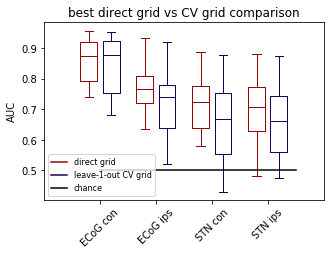

In [1011]:
plt.figure(figsize=(4.5,3), dpi=300)
my_box_plot_comparison([max_grid_ecog_con, max_grid_ecog_ips, max_grid_stn_con, max_grid_stn_ips], \
           [max_grid_CV_ecog_con, max_grid_CV_ecog_ips, max_grid_CV_stn_con, max_grid_CV_stn_ips], 4, \
            label_1='direct grid', label_2='leave-1-out CV grid')
plt.plot([0.5 for i in range(8)], label='chance', color = 'black')
plt.legend(loc='lower left', prop={'size': 8})
plt.title('best direct grid vs CV grid comparison')
plt.show()

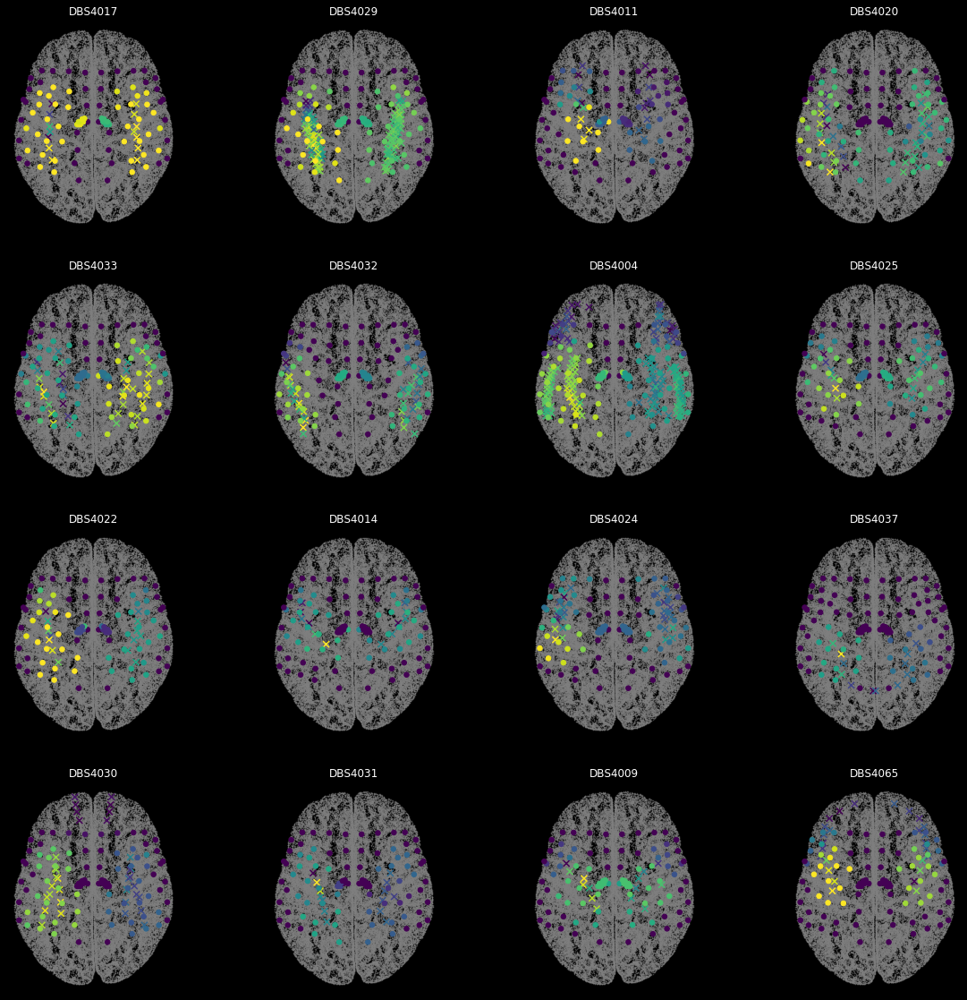

In [1219]:
#plot zwischen allen Patienten
plt.figure(figsize=(20,20), facecolor=(0, 0, 0))

x_ = Vertices['Vertices'][::4,0]
y_ = Vertices['Vertices'][::4,1]
z_ = np.zeros([x_.shape[0]])
l_coords = l_coords_con

for patient_idx in range(16):
    plt.subplot(4,4,patient_idx+1, facecolor=(0,0,0))
    plt.scatter(x_, y_, c='gray', s=0.25, alpha='0.5')
    plt.axis('off')
    #gucken dass contralaterale Raw channels links liegen

    plt.scatter(np.absolute(np.array(l_coords_con[patient_idx])[:,0])*-1, np.array(l_coords_con[patient_idx])[:,1], \
                       s = 50, alpha=1, marker='x', c = np.array(patients_con[patient_idx]))#c = np.array(patients_performance[patient_idx]), 

    plt.scatter(np.absolute(np.array(l_coords_con[patient_idx])[:,0]), np.array(l_coords_ips[patient_idx])[:,1], \
                       s = 50, alpha=1, marker='x', c = np.array(patients_ips[patient_idx]))#c = np.array(patients_performance[patient_idx]), 

    cbar = plt.colorbar()                            
    plt.clim(0.5, 0.9)
    cbar.remove()
    plt.scatter(grid[0,:], grid[1,:], c = patient_performance[patient_idx], s = 30, alpha=1)

    plt.title(list_DBS_folder[patient_idx], color='white')
    cbar = plt.colorbar()                            
    plt.clim(0.5, 0.9)
    cbar.remove()

In [169]:
#pro Patient die grid points über sessions concatenieren und dann plotten
l_patient_CV_NN = []
folder = 'NN'
for patient_idx in range(16):
    units_in_patient = get_units_in_patient(patient_idx)
    cc_arr = np.zeros(94)
    for unit in units_in_patient:
        start = 0
        for sess in np.where(patient_arr == patient_idx)[0]:
            if act_arr[sess,unit] == 0:
                continue   # nicht alle units sind in allen sessions...
            if start == 0:
                try:
                    y_te_pr = np.load(str(folder)+'/y_te_pr_unit_'+str(unit)+'_session_'+str(sess)+'.npy')
                except:
                    continue   # nicht alle units sind kreuzvalidiert
                mov = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
                start = 1
            else: 
                y_te_pr = np.concatenate((y_te_pr, np.load(str(folder)+'/y_te_pr_unit_'+str(unit)+'_session_'+str(sess)+'.npy')), axis=0)
                mov = np.concatenate((mov, np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')), axis=0)
        cc_arr[unit] = roc_auc_score(mov>0, y_te_pr)
    l_patient_CV_NN.append(cc_arr)
        

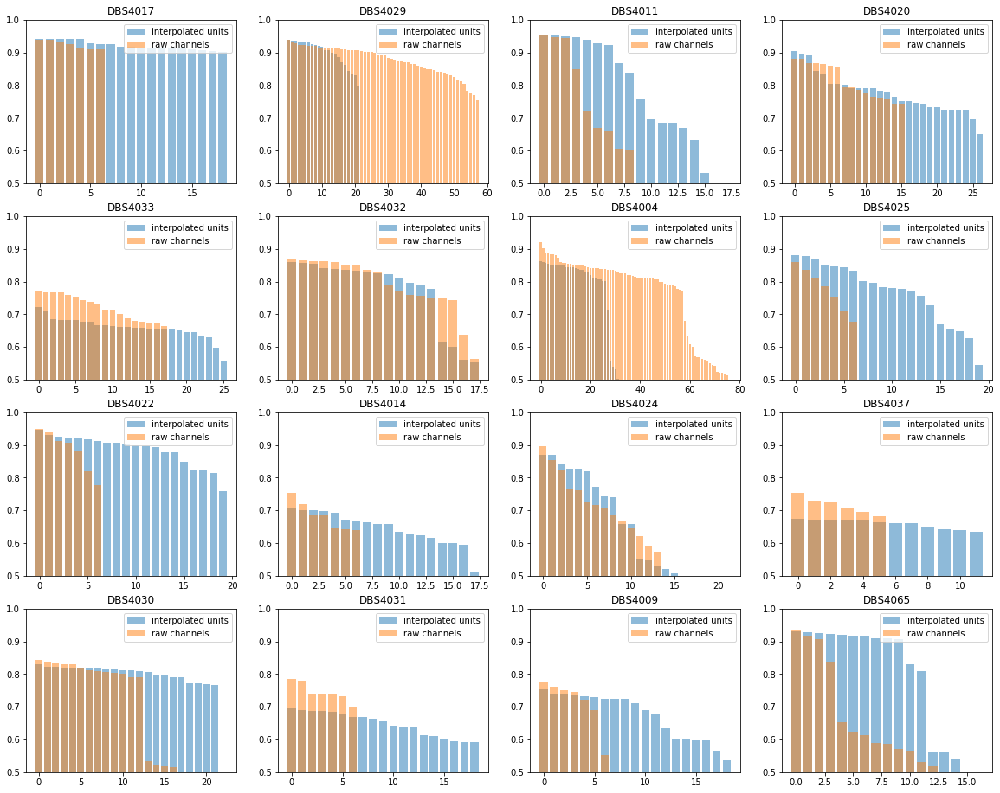

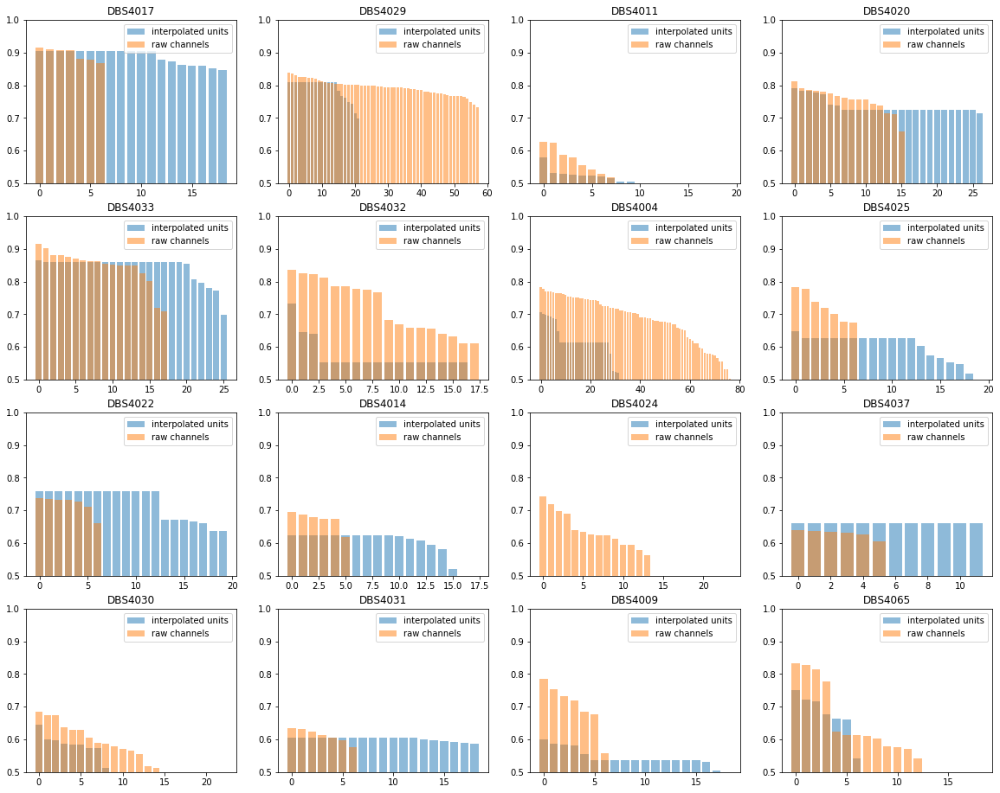

STN


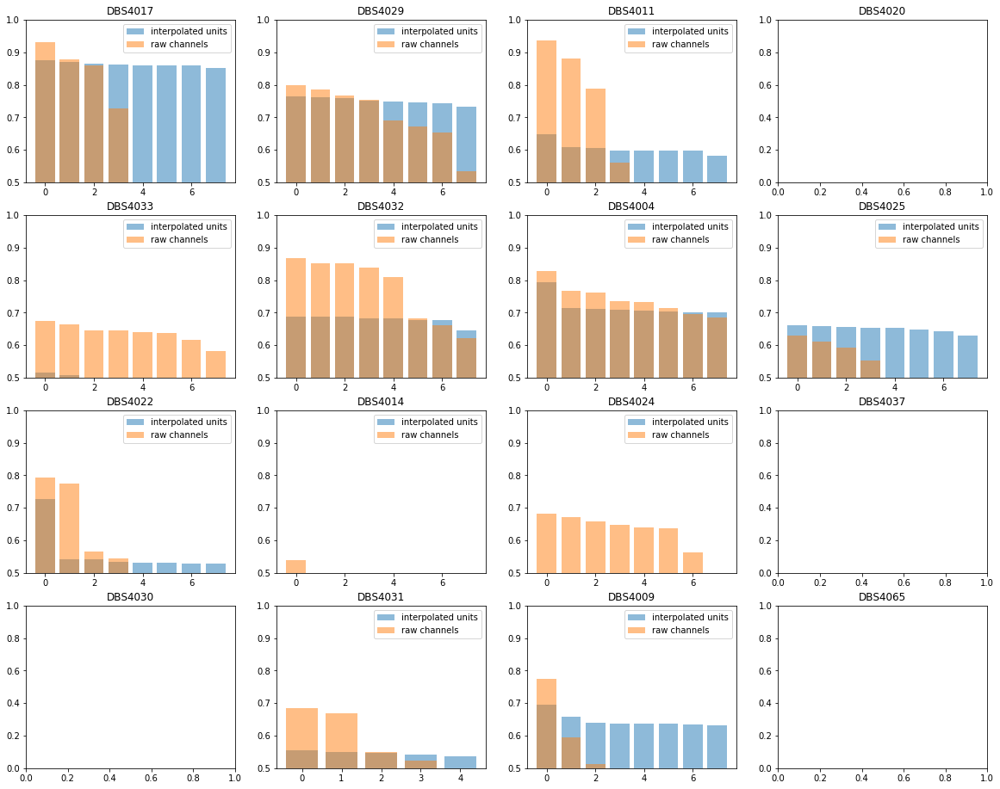

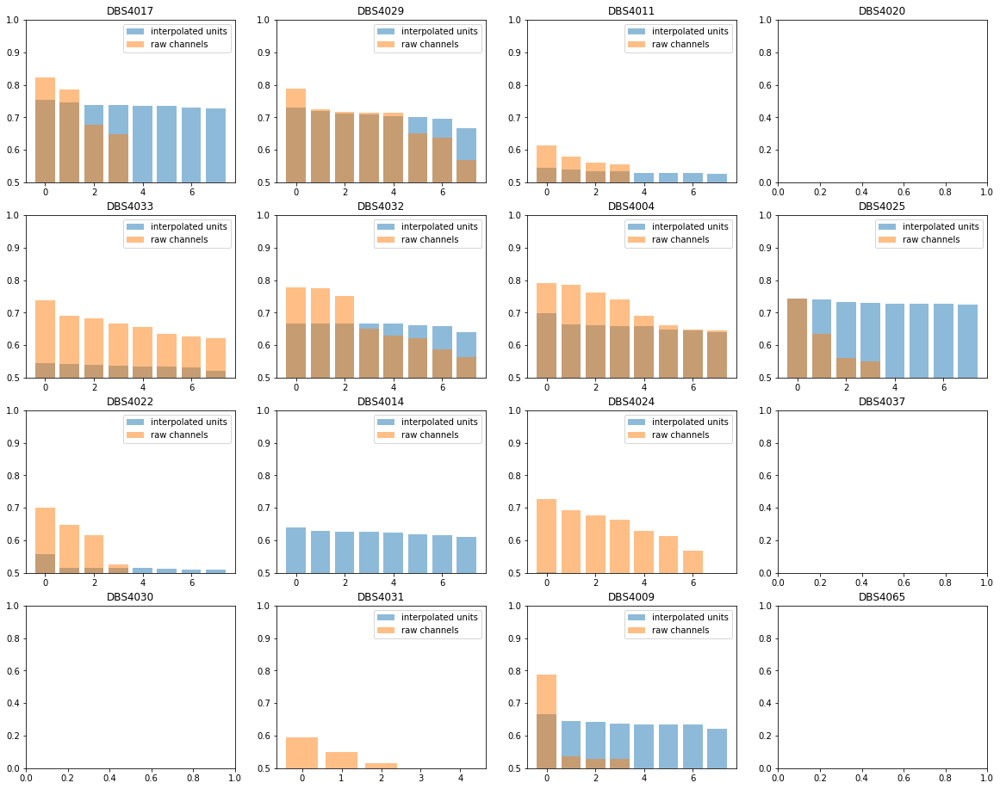

In [190]:
best_CV_NN = np.zeros([16, 4]) # 0 - con/inter, 1 - con/channel, 2 - ips/inter, 3 - ips/channel
plt.figure(figsize=(20, 16))
l_patient_list = l_patient_CV_NN
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    interpolated_ = l_patient_list[patient_idx][:38]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(patients_con[patient_idx])), np.sort(patients_con[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_NN[patient_idx, 0] = np.max(interpolated_)
    best_CV_NN[patient_idx, 1] = np.max(patients_con[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    interpolated_ = l_patient_list[patient_idx][38:78]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(patients_ips[patient_idx])), np.sort(patients_ips[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_NN[patient_idx, 2] = np.max(interpolated_)
    best_CV_NN[patient_idx, 3] = np.max(patients_ips[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

print('STN')

best_CV_stn_NN = np.zeros([16, 4]) # 0 - con/inter, 1 - con/channel, 2 - ips/inter, 3 - ips/channel
plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    interpolated_ = l_patient_list[patient_idx][78:86]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(stn_performance_con[patient_idx])), np.sort(stn_performance_con[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_stn_NN[patient_idx, 0] = np.max(interpolated_)
    best_CV_stn_NN[patient_idx, 1] = np.max(patients_con[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    interpolated_ = l_patient_list[patient_idx][86:]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(stn_performance_ips[patient_idx])), np.sort(stn_performance_ips[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_stn_NN[patient_idx, 2] = np.max(interpolated_)
    best_CV_stn_NN[patient_idx, 3] = np.max(patients_ips[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

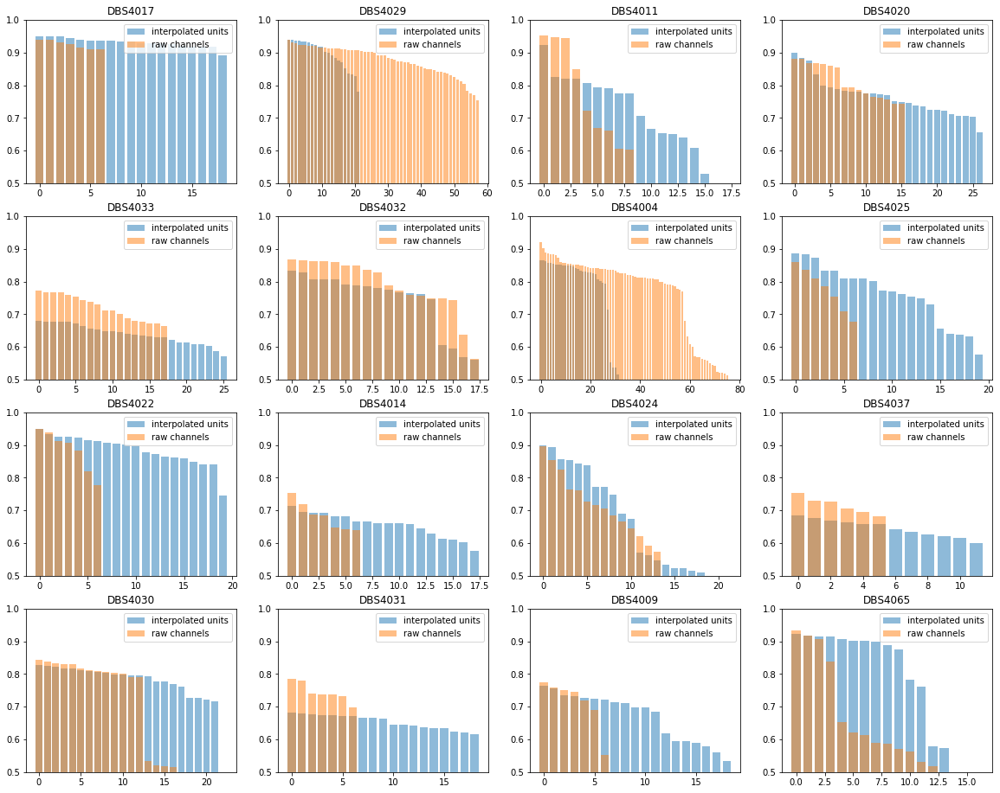

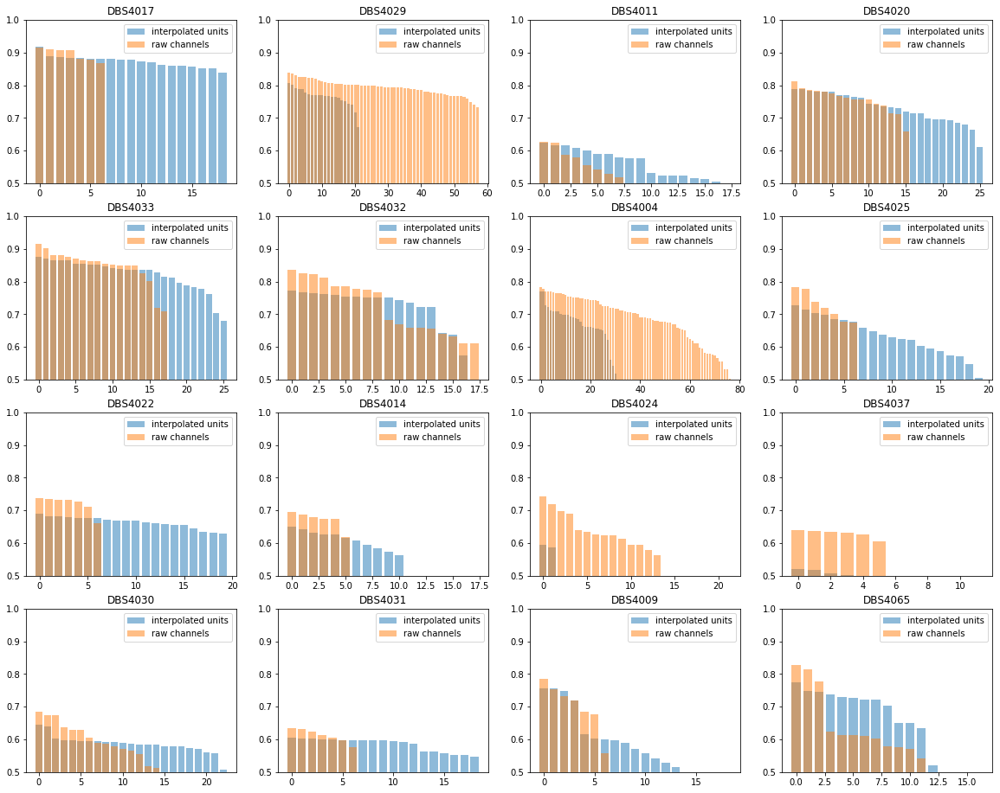

STN


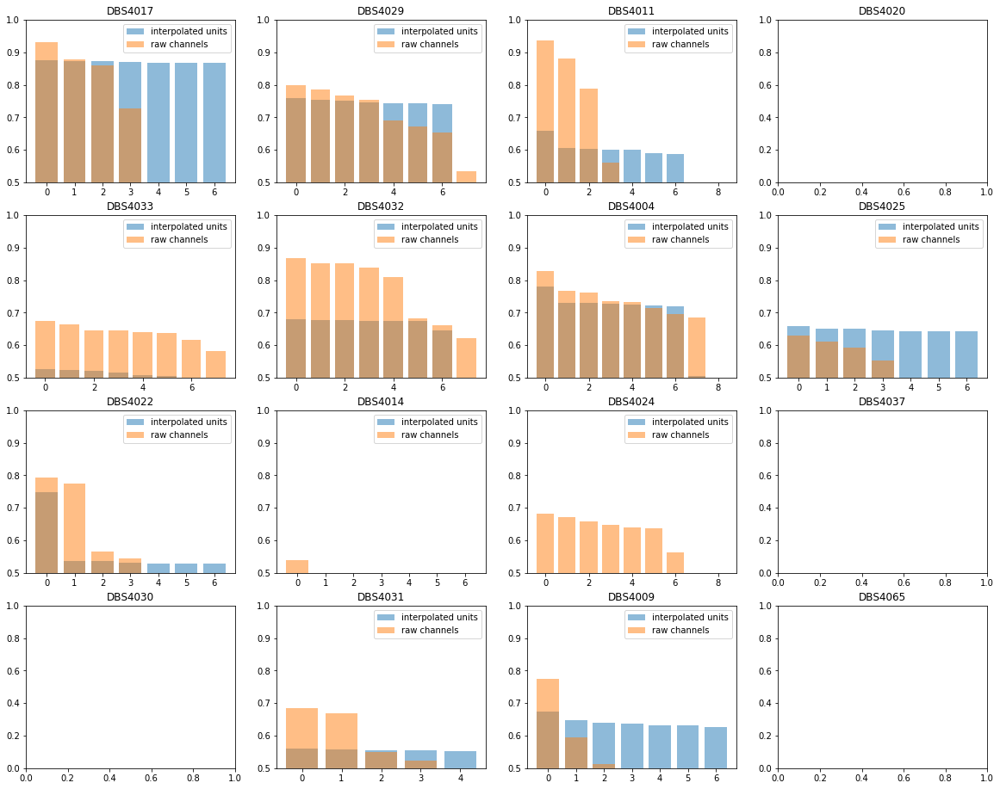

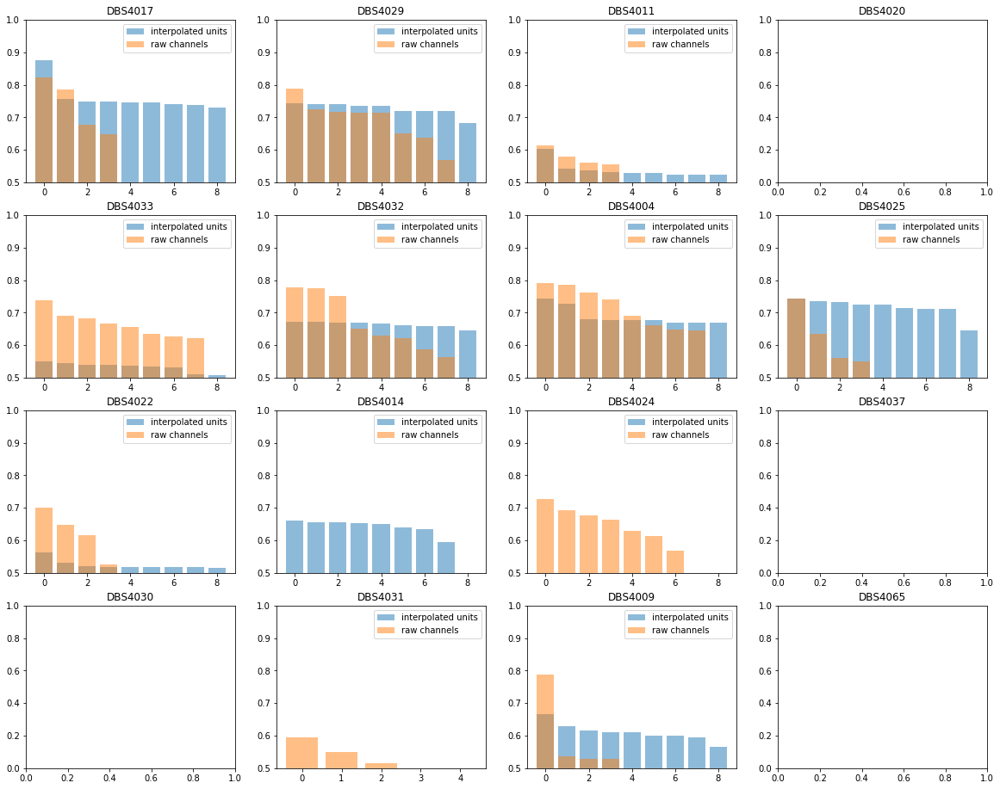

In [976]:
best_CV_LM = np.zeros([16, 4]) # 0 - con/inter, 1 - con/channel, 2 - ips/inter, 3 - ips/channel
l_patient_list = l_patient_CV_LM
plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    interpolated_ = l_patient_list[patient_idx][:38]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(patients_con[patient_idx])), np.sort(patients_con[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_LM[patient_idx, 0] = np.max(interpolated_)
    best_CV_LM[patient_idx, 1] = np.max(patients_con[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    interpolated_ = l_patient_list[patient_idx][38:76]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(patients_ips[patient_idx])), np.sort(patients_ips[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_LM[patient_idx, 2] = np.max(interpolated_)
    best_CV_LM[patient_idx, 3] = np.max(patients_ips[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

print('STN'); 

best_CV_stn_LM = np.zeros([16, 4]) # 0 - con/inter, 1 - con/channel, 2 - ips/inter, 3 - ips/channel
plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    interpolated_ = l_patient_list[patient_idx][76:85]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(stn_performance_con[patient_idx])), np.sort(stn_performance_con[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_stn_LM[patient_idx, 0] = np.max(interpolated_)
    best_CV_stn_LM[patient_idx, 1] = np.max(patients_con[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

plt.figure(figsize=(20, 16))
for patient_idx in range(16):
    plt.subplot(4,4, patient_idx+1)
    plt.title(list_DBS_folder[patient_idx])
    if len(stn_performance_con[patient_idx]) == 0:
        continue
    interpolated_ = l_patient_list[patient_idx][85:]
    interpolated_ = interpolated_[np.nonzero(interpolated_)[0]]
    plt.bar(np.arange(len(interpolated_)), np.sort(interpolated_)[::-1], label='interpolated units', alpha=0.5)
    plt.bar(np.arange(len(stn_performance_ips[patient_idx])), np.sort(stn_performance_ips[patient_idx])[::-1], label='raw channels', alpha=0.5)
    best_CV_stn_LM[patient_idx, 2] = np.max(interpolated_)
    best_CV_stn_LM[patient_idx, 3] = np.max(patients_ips[patient_idx])
    plt.legend()
    plt.ylim(0.5, 1)
plt.show()

In [198]:
print('CV NN vs Raw LM')
print('ECOG contralateral grid vs channel: ')
print(scipy.stats.ttest_ind(best_CV_NN[:,0], best_CV_NN[:,1]))
print()
print('ECOG ipsilateral grid vs channel ')
print(scipy.stats.ttest_ind(best_CV_NN[:,2], best_CV_NN[:,3]))
print();print()
print('STN contralateral grid vs channel: ')
print(scipy.stats.ttest_ind(best_CV_stn_NN[:,0], best_CV_stn_NN[:,1]))
print()
print('STN ipsilateral grid vs channel ')
print(scipy.stats.ttest_ind(best_CV_stn_NN[:,2], best_CV_stn_NN[:,3]))

print('')
print('CV LM vs Raw LM')
print('ECOG contralateral grid vs channel: ')
print(scipy.stats.ttest_ind(best_CV_LM[:,0], best_CV_LM[:,1]))
print()
print('ECOG ipsilateral grid vs channel ')
print(scipy.stats.ttest_ind(best_CV_LM[:,2], best_CV_LM[:,3]))
print();print()
print('STN contralateral grid vs channel: ')
print(scipy.stats.ttest_ind(best_CV_stn_LM[:,0], best_CV_stn_LM[:,1]))
print()
print('STN ipsilateral grid vs channel ')
print(scipy.stats.ttest_ind(best_CV_stn_LM[:,2], best_CV_stn_LM[:,3]))


### comparison CV NN directly vs CV LM --> better?
print('')
print('CV LM vs Raw LM')
print('ECOG contralateral CV NN vs CV LM: ')
print(scipy.stats.ttest_ind(best_CV_NN[:,0], best_CV_LM[:,0]))
print()
print('ECOG ipsilateral CV NN vs CV LM: ')
print(scipy.stats.ttest_ind(best_CV_NN[:,2], best_CV_LM[:,2]))
print();print()
print('STN contralateral CV NN vs CV LM: ')
print(scipy.stats.ttest_ind(best_CV_stn_NN[:,0], best_CV_stn_LM[:,0]))
print()
print('STN ipsilateral CV NN vs CV LM:')
print(scipy.stats.ttest_ind(best_CV_stn_NN[:,2], best_CV_stn_LM[:,2]))

CV NN vs Raw LM
ECOG contralateral grid vs channel: 
Ttest_indResult(statistic=-0.7090132983097306, pvalue=0.48379016847894174)

ECOG ipsilateral grid vs channel 
Ttest_indResult(statistic=-1.9048822648598653, pvalue=0.06642192221873232)


STN contralateral grid vs channel: 
Ttest_indResult(statistic=-1.269520156327518, pvalue=0.21401582305019506)

STN ipsilateral grid vs channel 
Ttest_indResult(statistic=-0.9641151428942124, pvalue=0.34269596948745695)

CV LM vs Raw LM
ECOG contralateral grid vs channel: 
Ttest_indResult(statistic=-0.8018919905214222, pvalue=0.4289219313206849)

ECOG ipsilateral grid vs channel 
Ttest_indResult(statistic=-1.3149269407069262, pvalue=0.19849776081732692)


STN contralateral grid vs channel: 
Ttest_indResult(statistic=-1.2990030206800822, pvalue=0.20383853159601056)

STN ipsilateral grid vs channel 
Ttest_indResult(statistic=-0.9212775263180775, pvalue=0.36425531347599316)

CV LM vs Raw LM
ECOG contralateral CV NN vs CV LM: 
Ttest_indResult(statistic=0.

Text(0.5, 1.0, 'STN ipsi CV predictions')

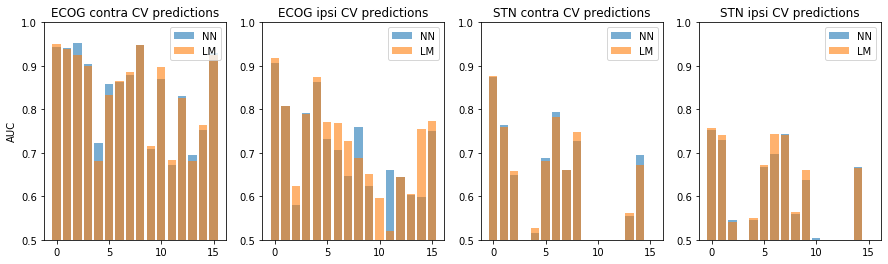

In [218]:
plt.figure(figsize=(15,4))
plt.subplot(141)
plt.bar(np.arange(16), best_CV_NN[:,0], label='NN', alpha=0.6)
plt.bar(np.arange(16), best_CV_LM[:,0], label='LM', alpha=0.6)
plt.ylabel('AUC')
plt.legend(); plt.ylim(0.5,1)
plt.title('ECOG contra CV predictions')
plt.subplot(142)
plt.bar(np.arange(16), best_CV_NN[:,2], label='NN', alpha=0.6)
plt.bar(np.arange(16), best_CV_LM[:,2], label='LM',alpha=0.6)
plt.legend(); plt.ylim(0.5,1)
plt.title('ECOG ipsi CV predictions')
plt.subplot(143)
plt.bar(np.arange(16), best_CV_stn_NN[:,0], label='NN', alpha=0.6)
plt.bar(np.arange(16), best_CV_stn_LM[:,0], label='LM', alpha=0.6)
plt.legend(); plt.ylim(0.5,1)
plt.title('STN contra CV predictions')
plt.subplot(144)
plt.bar(np.arange(16), best_CV_stn_NN[:,2], label='NN', alpha=0.6)
plt.bar(np.arange(16), best_CV_stn_LM[:,2], label='LM',alpha=0.6)
plt.legend(); plt.ylim(0.5,1)
plt.title('STN ipsi CV predictions')

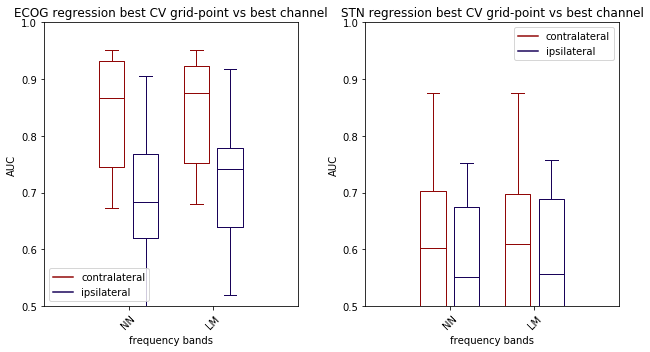

In [221]:
plt.figure(figsize=(9, 5))
plt.subplot(121)
my_box_plot_comparison(np.concatenate((np.expand_dims(best_CV_NN[:,0], axis=1), \
                                       np.expand_dims(best_CV_LM[:,0], axis=1)), axis=1), \
                       np.concatenate((np.expand_dims(best_CV_NN[:,2], axis=1), \
                                       np.expand_dims(best_CV_LM[:,2], axis=1)), axis=1))
plt.title('ECOG regression best CV grid-point vs best channel')
plt.ylim(0.5, 1)
plt.xticks(range(0, 2 * 2, 2), ['NN', 'LM'], rotation=45)
plt.legend()
plt.subplot(122)
my_box_plot_comparison(np.concatenate((np.expand_dims(best_CV_stn_NN[:,0], axis=1), \
                                       np.expand_dims(best_CV_stn_LM[:,0], axis=1)), axis=1), \
                       np.concatenate((np.expand_dims(best_CV_stn_NN[:,2], axis=1), \
                                       np.expand_dims(best_CV_stn_LM[:,2], axis=1)), axis=1))
plt.title('STN regression best CV grid-point vs best channel')
plt.ylim(0.5, 1)
plt.xticks(range(0, 2 * 2, 2), ['NN', 'LM'], rotation=45)
plt.legend()
plt.tight_layout()

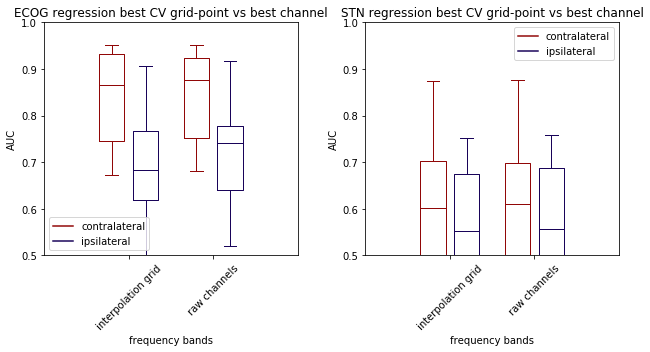

In [197]:
plt.figure(figsize=(9, 5))
plt.subplot(121)
my_box_plot_comparison(np.concatenate((np.expand_dims(best_CV_NN[:,0], axis=1), \
                                       np.expand_dims(best_CV_LM[:,0], axis=1)), axis=1), \
                       np.concatenate((np.expand_dims(best_CV_NN[:,2], axis=1), \
                                       np.expand_dims(best_CV_LM[:,2], axis=1)), axis=1))
plt.title('ECOG regression best CV grid-point vs best channel')
plt.ylim(0.5, 1)
plt.legend()
plt.subplot(122)
my_box_plot_comparison(np.concatenate((np.expand_dims(best_CV_stn_NN[:,0], axis=1), \
                                       np.expand_dims(best_CV_stn_LM[:,0], axis=1)), axis=1), \
                       np.concatenate((np.expand_dims(best_CV_stn_NN[:,2], axis=1), \
                                       np.expand_dims(best_CV_stn_LM[:,2], axis=1)), axis=1))
plt.title('STN regression best CV grid-point vs best channel')
plt.ylim(0.5, 1)
plt.legend()
plt.tight_layout()

In [239]:
t_arr = np.zeros([16])
for patient_idx in range(16):
    NN_ = l_patient_CV_NN[patient_idx][np.nonzero(l_patient_CV_NN[patient_idx])]
    LM_ = l_patient_CV_LM[patient_idx][np.nonzero(l_patient_CV_LM[patient_idx])]
    t_arr[patient_idx] = stats.ttest_ind(NN_, LM_)[0]

Text(0.5, 1.0, 't statistics CV NN vs LM')

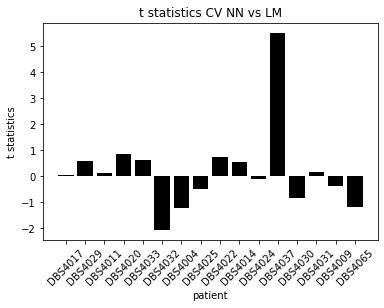

In [247]:
plt.bar(np.arange(16), t_arr, color='black')
plt.ylabel('t statistics')
plt.xticks(np.arange(16), list_DBS_folder, rotation=45)
plt.xlabel('patient')
plt.title('t statistics CV NN vs LM')

In [242]:
np.median(t_arr)

0.08656567198892912

In [243]:
np.mean(t_arr)

0.18286826198444978

The cross validated NN performs significantly better only on patient DBS4024

In [233]:
 # wenn stat positiv, dann NN besser

Ttest_indResult(statistic=0.06027300107494179, pvalue=0.9520516963560142)

In [234]:
np.mean(NN_) 

0.8748685680857785

In [235]:
np.mean(LM_)

0.8741405883276044

In [249]:
import unit_combine

In [268]:
gridpoints_to_use.shape

(8, 94)

In [271]:
patient_in_point = np.load('../final/helper_files/patients_in_point.npy', allow_pickle=True)

In [273]:
patient_in_point.shape

(94,)

In [489]:
def get_train_test_CC(folder):
    unit_CC_test = np.zeros([144, 94])
    unit_CC_patient = np.zeros([16, 94])
    #plot für alle units den mean CC
    for unit in range(94):
        if np.sum(gridpoints_to_use[:,unit])>0:
            if len(patient_in_point[unit]) <=1:
                continue
            for sess in np.nonzero(act_arr[:, unit])[0]:
                y_te = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
                y_te_pr = np.load(str(folder)+'/y_te_pr_unit_'+str(unit)+'_session_'+str(sess)+'.npy')
                unit_CC_test[sess, unit] = np.corrcoef(y_te, y_te_pr)[0][1]
            for patient_test in patient_in_point[unit]:
                unit_CC_patient[patient_test, unit] = np.load(str(folder)+'/corr_coeff_unit_'+str(unit)+'_patient_'+str(patient_test)+'.npy')

    return unit_CC_patient, unit_CC_test

def get_list_mean_std(unit_CC_train_NN, folder):
    sess_find_ = np.zeros([3, 144])
    sess_true_ = []
    sess_pred_mean = []
    sess_pred_std = []
    sess_pred_diff = []
    for sess in range(144):
        units_in_session, weight_unit = get_units_and_weights_per_session(sess, unit_CC_train_NN)
        dat, y_true = read_dat(sess, units_in_session, folder)
        y_pred_mean, y_pred_std, y_pred_diff = get_mean_std_diff(dat, weight_unit)
        #for list_idx, list_ in enumerate([y_pred_mean, y_pred_std, y_pred_diff]):
        #    sess_find_[list_idx, sess] = np.corrcoef(y_true, list_)[0][1]
        sess_true_.append(y_true); sess_pred_mean.append(y_pred_mean); sess_pred_std.append(y_pred_std); sess_pred_diff.append(y_pred_diff)
    return sess_true_, sess_pred_mean, sess_pred_std, sess_pred_diff

def read_dat(sess, units_in_session, folder):
    for unit_idx, unit in enumerate(units_in_session):
        if unit_idx == 0:
            dat = np.expand_dims(np.load(folder+'/y_te_pr_unit_'+str(unit)+'_session_'+str(sess)+'.npy'), axis=0)
        else:
            dat = np.concatenate((dat, np.expand_dims(np.load(folder+'/y_te_pr_unit_'+str(unit)+'_session_'+str(sess)+'.npy'), axis=0)), axis = 0)
    y_true = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
    return dat, y_true

def get_units_and_weights_per_session(sess, unit_CC_train_NN):
    patient_in_sess = patient_arr[sess]
    units_in_session = np.nonzero(act_arr[sess,:])[0]
    units_ = []
    for unit in units_in_session:
        if len(patient_in_point[unit]) <=1:
            continue
        else:
            units_.append(unit)
    units_in_session = np.array(units_)
    weights_ = unit_CC_train_NN[patient_in_sess,:]
    weight_unit = []
    for unit in units_in_session:
        weight_unit.append(weights_[unit])
    weight_unit = np.array(weight_unit) / np.sum(np.array(weight_unit))
    return units_in_session, weight_unit

def get_mean_std_diff(dat, weight_unit):
    #Mittelwert
    for unit_idx in range(dat.shape[0]):
        if unit_idx == 0:
            y_pred_mean = weight_unit[unit_idx]*dat[unit_idx,:]
        else:
            y_pred_mean += weight_unit[unit_idx]*dat[unit_idx,:]

    #Standardabweichung
    y_pred_std = np.std(dat, axis = 0)

    #Ableitung pro unit
    out_diff = np.zeros([dat.shape[0], dat.shape[1]])
    for unit in range(dat.shape[0]):
        out_diff[unit,1:] = np.diff(dat[unit,:], axis=0)

    for unit_idx in range(out_diff.shape[0]):
        if unit_idx == 0:
            y_pred_diff = weight_unit[unit_idx]*out_diff[unit_idx,:]
        else:
            y_pred_diff += weight_unit[unit_idx]*out_diff[unit_idx,:]
    return y_pred_mean, y_pred_std, y_pred_diff

def read_out_sess(patient_test, folder, sess_pred_mean, sess_pred_std, lat='contra', for_train=True):
    '''
    param: sess_pred_mean, sess_pred_std: arrays of combined mean/std (one dimension) weighted by train performance 
    if train=True returns an array of time and mean/std/method concatenated for all patients except patient_test
    if train =False return the array only for patient_test
    '''
    start = 0
    if for_train == True:
        sess_ = np.where(patient_arr != patient_test)[0]
    else:
        sess_ = np.where(patient_arr == patient_test)[0]
    for sess in sess_:
        if lat == 'contra':
            if np.nonzero(act_arr[sess,:])[0][1] >= 38:
                continue
        elif lat =='ipsi':
             if np.nonzero(act_arr[sess,:])[0][1] < 38:
                continue
        y_te = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
        #now calculate mean, diff, std
        x_train_mean, y_train = get_train_time(y_te, sess_pred_mean[sess], points = time, start = 0, end=y_te.shape[0])
        x_train_std, y_train = get_train_time(y_te, sess_pred_std[sess], points = time, start = 0, end=y_te.shape[0])
        x_train = np.concatenate((x_train_mean, x_train_std), axis=1)
        if start == 0:
            start = 1
            x_tot = x_train; y_tot = y_train
        else:
            x_tot = np.concatenate((x_tot, x_train), axis=0); y_tot = np.concatenate((y_tot, y_train), axis=0);
        x_train = x_tot; y_train = y_tot
    return x_train, y_train

def get_train_time(y_te_tot, y_te_pr_tot, points = 5, start = 0, end = 10000):
    x_train = np.expand_dims(y_te_pr_tot[start:end-points],axis=1)
    for i in range(start+1, start+points):
        x_train = np.concatenate((x_train, np.expand_dims(y_te_pr_tot[i:end-(points-i)], axis=1)), axis=1)
    y_train = y_te_tot[start + points:end]
    return x_train, y_train

def define_model(input_dim, patient_test, act_func, time):
    es = EarlyStopping(monitor='val_loss', verbose=1, patience=2, min_delta=0.01) # patient early stopping
    mc = ModelCheckpoint('best_model_'+str(patient_test)+str(time)+'.h5', monitor='val_loss', verbose=1, save_best_only=True)
    model = Sequential()
    hidden_unit = int(input_dim * 0.4)
    model.add(Dense(hidden_unit, activation=act_func, input_dim=input_dim))
    model.add(Dense(1, activation='linear', input_dim=hidden_unit))
    optimizer = optimizers.Adam()
    model.compile(optimizer=optimizer, loss='mean_squared_error', metrics=['accuracy'])
    return model, es, mc


def CV_unit_combine(time, folder_out, epochs=10, act_func='tanh', folder='LM'):
    
    unit_CC_train_NN, unit_CC_test = get_train_test_CC(folder)
    sess_true_, sess_pred_mean, sess_pred_std, sess_pred_diff = \
            get_list_mean_std(unit_CC_train_NN, folder) # load list of true, mean and pred sessions
    
    for lat_ in ['contra']:  # 'ipsi'
        print(lat_)
        loss_arr = []; cc_ = []; weights = []
        for patient_test in range(16):
            print(str(list_DBS_folder[patient_test]))
            x_train, y_train = read_out_sess(patient_test = patient_test, folder = folder, \
                                 sess_pred_mean = sess_pred_mean, sess_pred_std = sess_pred_std, \
                                 lat=lat_, for_train=True)
            x_test, y_test = read_out_sess(patient_test = patient_test, folder = folder, \
                                             sess_pred_mean = sess_pred_mean, sess_pred_std = sess_pred_std, \
                                             lat=lat_, for_train=False)
            #X_train, X_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.4, shuffle=False)
            #X_ = np.concatenate((X_train, np.expand_dims(y_train, axis=1)), axis=1)
            #np.random.shuffle(X_)
            #X_train = X_[:,:-1]; y_train = X_train[:,-1]
            
            model, es, mc = define_model(x_train.shape[1], patient_test, act_func, time)
            hist = model.fit(x_train, y_train, epochs=1,\
                            verbose=1) #validation_data=(X_val, y_val), callbacks=[es,mc]
            
            #model = load_model('best_model_'+str(patient_test)+str(time)+'.h5')
            y_pr = model.predict(x_test)[:,0]
            np.save(folder_out + '/y_pr_patient_'+str(patient_test)+'_time_'+str(time)+'.npy', y_pr)
            np.save(folder_out + '/y_true_patient_'+str(patient_test)+'_time_'+str(time)+'.npy', y_test)
            cc_.append(np.corrcoef(y_test, y_pr)[0][1]); loss_arr.append(hist.history['loss'])
            weights.append(model.get_weights())
            
        np.save(folder_out+'/weights_'+lat_+'_time_'+str(time)+'.npy', weights)
        np.save(folder_out+'/cc_'+lat_+'_time_'+str(time)+'.npy', cc_)
        np.save(folder_out+'/loss_'+lat_+'_time_'+str(time)+'.npy',loss_arr)



In [1033]:
#first: just weighted LM: for all sessions of that patient, concatenate the true output and mean
#then: calculate AUC and compare to best channel direct

#in sess_pred_mean[0] schon weighted mean enthalten
AUC_con = []
AUC_ips = []
for patient_idx in range(16):
    for lat_ in range(2): #lat_ = 0: con, lat_ = 1: ips 
        start = 0   
        for sess in np.where(patient_arr == patient_idx)[0]:
            if lat_ == 0 and np.nonzero(act_arr[sess, :])[0][1]>=38:
                continue
            elif lat_ == 1 and np.nonzero(act_arr[sess, :])[0][1]<38:
                continue
            if start == 0:
                y_true = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
                y_pred = sess_pred_mean[sess] 
            else:
                y_true = np.concatenate((y_true, np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')), axis=0)
                y_pred = np.concatenate((y_pred, sess_pred_mean[sess]), axis=0)
        if lat_ == 0:
            AUC_con.append(roc_auc_score(y_true>0, y_pred))
        else:
            AUC_ips.append(roc_auc_score(y_true>0, y_pred))
    

In [1076]:
print(np.mean(AUC_con))
print(np.std(AUC_con))
print(np.mean(AUC_ips))
print(np.std(AUC_ips))

0.8146187457926927
0.12081420794381963
0.6769440928379773
0.1267244521696567


In [1080]:
print(scipy.stats.ttest_ind(max_grid_CV_ecog_con, AUC_con))
print(scipy.stats.ttest_ind(max_grid_CV_ecog_ips, AUC_ips))

Ttest_indResult(statistic=0.6026568892335148, pvalue=0.5512657638042342)
Ttest_indResult(statistic=1.0096465485232005, pvalue=0.32073912852490283)


Ttest_indResult(statistic=2.2284210389658115, pvalue=0.033495321750985574)

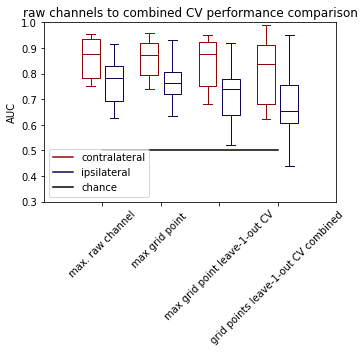

In [1224]:
plt.figure(figsize=(5,5))
my_box_plot_comparison([max_ch_ecog_con, max_grid_ecog_con, max_grid_CV_ecog_con, AUC_con], \
                       [max_ch_ecog_ips, max_grid_ecog_ips, max_grid_CV_ecog_ips, AUC_ips], 4, \
                       'contralateral', 'ipsilateral')

plt.title('raw channels to combined CV performance comparison')
plt.ylim(0.3, 1)
ticks = 4
plt.xticks(range(0, ticks * 2, 2), ['max. raw channel', 'max grid point ', \
                                         'max grid point leave-1-out CV', 'grid points leave-1-out CV combined'], \
           rotation=45)
   # plt.xticks(range(0, len(ticks) * 2, 2), ['ECoG con', 'ECoG ips', 'STN con', 'STN ips'], rotation=45)

plt.plot([0.5 for i in np.arange(-1, 6, 1)], label='chance', color='black')
plt.legend()
plt.tight_layout()

### picking only the best grid point, based on the val. error

In [1225]:
def get_best_grid_point(patient_idx, con=True):
    grid_points_ = get_units_in_patient(patient_idx)
    if con==True:
        grid_points_ = grid_points_[np.where(grid_points_<38)[0]]
    else:
        grid_points_ = grid_points_[np.where(grid_points_>=38)[0]]
    l_= []  
    for grid_point in grid_points_:
        l_.append(np.load(str(folder)+'/corr_coeff_unit_'+str(grid_point)+'_patient_'+str(patient_idx)+'.npy'))
    return grid_points_, l_

In [1169]:
grid_points_, l_ = get_best_grid_point(0, False)

In [1226]:
#first: just weighted LM: for all sessions of that patient, concatenate the true output and mean
#then: calculate AUC and compare to best channel direct
#in sess_pred_mean[0] schon weighted mean enthalten
AUC_con_best_val = []
AUC_ips_best_val = []
folder = 'LM'
for patient_idx in range(16):
    
    for lat_ in range(2): #lat_ = 0: con, lat_ = 1: ips 
        start = 0   
        if lat_==0:
            grid_points_, l_ = get_best_grid_point(patient_idx, True)
            grid_point_best_val = grid_points_[np.argmax(l_)]
        else:
            grid_points_, l_ = get_best_grid_point(patient_idx, False)
            grid_point_best_val = grid_points_[np.argmax(l_)]
            
        for sess in np.where(patient_arr == patient_idx)[0]:
            if lat_ == 0 and np.nonzero(act_arr[sess, :])[0][1]>=38:
                continue
            elif lat_ == 1 and np.nonzero(act_arr[sess, :])[0][1]<38:
                continue
            if start == 0:
                try:
                    y_pred = np.load(folder+'/y_te_pr_unit_'+str(grid_point_best_val)+'_session_'+str(sess)+'.npy') 
                except:
                    print('could not find grid point: '+str(grid_point_best_val)+' in session: '+str(sess)+\
                         ' for patient: '+str(patient_idx))
                    pass
                y_true = np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')
                start = 1

            else:
                y_pred = np.concatenate((y_pred, np.load(folder+'/y_te_pr_unit_'+str(grid_point_best_val)+'_session_'+str(sess)+'.npy') ), axis=0)
                y_true = np.concatenate((y_true, np.load('../final/corr_stream/mov_session_'+str(sess)+'.npy')), axis=0)
        if lat_ == 0:
            AUC_con_best_val.append(roc_auc_score(y_true>0, y_pred))
        else:
            AUC_ips_best_val.append(roc_auc_score(y_true>0, y_pred))



could not find grid point: 8 in session: 27 for patient: 3


FileNotFoundError: [Errno 2] No such file or directory: 'LM/y_te_pr_unit_8_session_31.npy'

In [ ]:
time=0; folder='LM'
unit_CC_train_NN, unit_CC_test = get_train_test_CC(folder)
sess_true_, sess_pred_mean, sess_pred_std, sess_pred_diff = \
        get_list_mean_std(unit_CC_train_NN, folder) # load list of true, mean and pred sessions

for lat_ in ['contra']:  # 'ipsi'
    print(lat_)
    loss_arr = []; cc_ = []; weights = []
    for patient_test in range(16):
        print(str(list_DBS_folder[patient_test]))
        x_train, y_train = read_out_sess(patient_test = patient_test, folder = folder, \
                             sess_pred_mean = sess_pred_mean, sess_pred_std = sess_pred_std, \
                             lat=lat_, for_train=True)
        x_test, y_test = read_out_sess(patient_test = patient_test, folder = folder, \
                                         sess_pred_mean = sess_pred_mean, sess_pred_std = sess_pred_std, \
                                         lat=lat_, for_train=False)


In [494]:
time=0;folder_out='comb_LM';epochs=10;act_func='tanh';folder='LM'

unit_CC_train_NN, unit_CC_test = get_train_test_CC(folder)
sess_true_, sess_pred_mean, sess_pred_std, sess_pred_diff = \
        get_list_mean_std(unit_CC_train_NN, folder) # load list of true, mean and pred sessions

for lat_ in ['contra']:  # 'ipsi'
    print(lat_)
    loss_arr = []; cc_ = []; weights = []
    for patient_test in range(16):
        print(str(list_DBS_folder[patient_test]))
        x_train, y_train = read_out_sess(patient_test = patient_test, folder = folder, \
                             sess_pred_mean = sess_pred_mean, sess_pred_std = sess_pred_std, \
                             lat=lat_, for_train=True)
        x_test, y_test = read_out_sess(patient_test = patient_test, folder = folder, \
                                         sess_pred_mean = sess_pred_mean, sess_pred_std = sess_pred_std, \
                                         lat=lat_, for_train=False)
        #X_train, X_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.4, shuffle=False)
        #X_ = np.concatenate((X_train, np.expand_dims(y_train, axis=1)), axis=1)
        #np.random.shuffle(X_)
        #X_train = X_[:,:-1]; y_train = X_train[:,-1]

        model, es, mc = define_model(x_train.shape[1], patient_test, act_func, time)
        hist = model.fit(x_train, y_train, epochs=1,\
                        verbose=1) #validation_data=(X_val, y_val), callbacks=[es,mc]

        #model = load_model('best_model_'+str(patient_test)+str(time)+'.h5')
        y_pr = model.predict(x_test)[:,0]
        np.save(folder_out + '/y_pr_patient_'+str(patient_test)+'_time_'+str(time)+'.npy', y_pr)
        np.save(folder_out + '/y_true_patient_'+str(patient_test)+'_time_'+str(time)+'.npy', y_test)
        cc_.append(np.corrcoef(y_test, y_pr)[0][1]); loss_arr.append(hist.history['loss'])
        weights.append(model.get_weights())

    np.save(folder_out+'/weights_'+lat_+'_time_'+str(time)+'.npy', weights)
    np.save(folder_out+'/cc_'+lat_+'_time_'+str(time)+'.npy', cc_)
    np.save(folder_out+'/loss_'+lat_+'_time_'+str(time)+'.npy',loss_arr)



contra
DBS4017
Train on 144217 samples
144217/144217 [==============================] - 7s 51us/sample - loss: 3.3754 - accuracy: 0.0000e+00s - loss: 3.3
DBS4029
Train on 132795 samples
 33920/132795 [======>.......................] - ETA: 6s - loss: 3.5572 - accuracy: 0.0000e+00

KeyboardInterrupt: 

In [1021]:
x_train.shape

(132795, 2)

In [579]:
sess = 2
folder = 'LM'
units_in_session, weight_unit_con = get_units_and_weights_per_session(sess, unit_CC_train_NN)
dat_con, y_true = read_dat(sess, units_in_session, folder)
y_pred_mean, y_pred_std, y_pred_diff = get_mean_std_diff(dat, weight_unit)
sess = 1
folder = 'LM'
units_in_session, weight_unit_ips = get_units_and_weights_per_session(sess, unit_CC_train_NN)
dat_ips, y_true = read_dat(sess, units_in_session, folder)


In [ ]:
plt.subplot(211)
plt.plot(np.arange(sess_true_[2].shape[0])*0.1, sess_true_[2], label='contralateral movements')
plt.plot(np.arange(sess_true_[1].shape[0])*0.1, sess_true_[1], label='ipsilateral movements')
plt.plot(np.arange(sess_true_[2].shape[0])*0.1, sess_pred_mean[2], label='contralateral predictions')
plt.plot(np.arange(sess_true_[1].shape[0])*0.1, sess_pred_mean[1],  label='ipsilateral predictions')
plt.ylabel('force z-scored')
plt.xlabel('time [s]')
plt.title('mean weighted unit prediction')
plt.legend()

In [585]:
dat_con.shape

(19, 2111)

In [587]:
dat_ips.shape

(19, 2032)

In [602]:
label_ = []
for i in range(10):
    label_.append('con   '+str(i))
for i in range(10,19):
    label_.append('con '+str(i))
for i in range(10):
    label_.append('ips   '+str(i))
for i in range(10,19):
    label_.append('ips '+str(i))

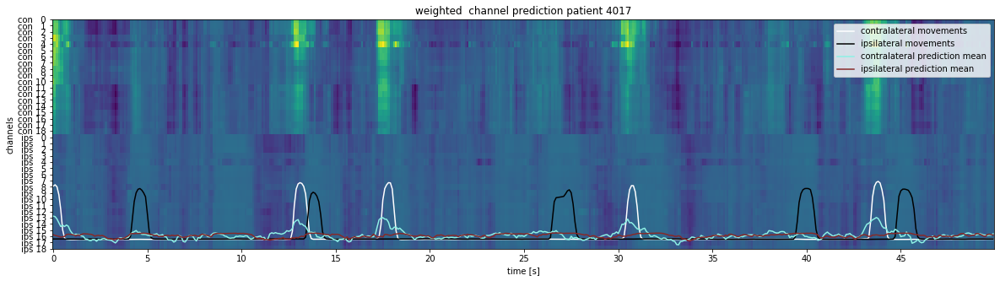

In [822]:
plt.figure(figsize=(20,5))
start = 500
end = 1000
plt.imshow(np.concatenate((dat_con[:,start:end], dat_ips[:,start:end]), axis=0), aspect='auto')
plt.plot(sess_true_[2][start:end]*-1+35, label='contralateral movements', color='white')
plt.plot(sess_true_[1][start:end]*-1+35, label='ipsilateral movements', color='black')
plt.plot(sess_pred_mean[2][start:end]*-1+35, label='contralateral prediction mean', color='#8df1e5')
plt.plot(sess_pred_mean[1][start:end]*-1+35, label='ipsilateral prediction mean', color='#872929')
plt.legend()
plt.ylabel('channels')
plt.xlabel('time [s]')
plt.yticks(np.arange(19*2), label_)
plt.xticks(np.arange(0, end-start, 50), np.array(np.arange(0, end-start, 50)*0.1).astype(int))
plt.title('weighted  channel prediction patient 4017')
plt.show()